In [1]:
import os
from sklearn.utils import shuffle
import time
import cv2
import tqdm
from PIL import Image
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers.core import Activation
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D
from keras.layers.core import Flatten, Dropout
from keras.layers import Input, merge, MaxPool2D, Lambda
from keras.layers.pooling import MaxPooling2D
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.models import Model
from keras.optimizers import SGD, Adam, RMSprop
from keras.layers.advanced_activations import LeakyReLU
import matplotlib.pyplot as plt
#from misc_layers import MinibatchDiscrimination, SubPixelUpscaling, CustomLRELU, bilinear2x
#from keras_contrib.layers import SubPixelUpscaling
import keras.backend as K
from keras.initializers import RandomNormal
#K.set_image_dim_ordering('tf')

import glob
os.environ["KERAS_BACKEND"] = "tensorflow"
from sklearn.utils import shuffle
import scipy
import imageio
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from keras.models import load_model
import keras.backend as K
#from scipy.interpolate import spline
import numpy as np

from collections import deque
import skimage
np.random.seed(1337)

Using TensorFlow backend.


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
def norm_img(img):
    img = (img / 127.5) - 1
    #image normalisation to keep values between -1 and 1 for stability
    return img

def denorm_img(img):
    #for output
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 

In [0]:
#можно заменить на датагенератор
def sample_from_dataset(batch_size, image_shape, data_dir=None, data = None):
    sample_dim = (batch_size,) + image_shape
    sample = np.empty(sample_dim, dtype=np.float32)
    all_data_dirlist = list(glob.glob(data_dir))
    sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)
    for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        #image = image.convert('RGB')
        image = np.asarray(image)
        image = norm_img(image[:,:,:1])
        sample[index,...] = image
    return sample

In [0]:
def image_read(image_shape,data_dir):
  im_list = []
  for i, image_path in enumerate(glob.glob(data_dir)):
    image = Image.open(image_path)
    image = image.resize(image_shape[:-1])
    image = image.convert('RGB')
    image = np.asarray(image)
    image = norm_img(image)
    im_list.append(image)
  return np.array(im_list)

In [0]:
def gen_noise(batch_size, noise_shape):
    #input noise for the generator should follow a probability distribution, like in this case, the normal distributon.
    return np.random.normal(0, 1, size=(batch_size,)+noise_shape)

In [0]:
def generate_images(generator, save_dir):

    noise = gen_noise(batch_size,noise_shape)
    fake_data_X = generator.predict(noise)
    print("Displaying generated images")
    plt.figure(figsize=(4,4))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(fake_data_X.shape[0],16,replace=False)
    for i in range(16):
        #plt.subplot(4, 4, i+1)
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = fake_data_X[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(save_dir+str(time.time())+"_GENimage.png",bbox_inches='tight',pad_inches=0)
    plt.show()

In [0]:
def save_img_batch(img_batch,img_save_dir):
    plt.figure(figsize=(4,4))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],16,replace=False)
    for i in range(16):
        #plt.subplot(4, 4, i+1)
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:].reshape(image_shape[:-1])
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show()   

### Параметры

In [0]:
noise_shape = (1,1,400)
latent_dim = 400
num_steps = 10000
batch_size = 20
image_shape = None
img_save_dir = '/content/drive/My Drive/deep learn/dataBrainMRI_256/results_vaegan_256/'
#"/content/drive/My Drive/deep learn/anime_results/"
save_model = True
image_shape = (256,256,1)
data_dir = '/content/drive/My Drive/deep learn/dataBrainMRI_256/healthy_original/*.png'  
#'/content/drive/My Drive/deep learn/anime/*.png'

log_dir = img_save_dir
save_model_dir = img_save_dir

----------------------------------------

## VAE, ГЕНЕРАТОР И ДИСКРИМИНАТОР

In [0]:
def get_vae_normal(conv_size = 16, count_kernels = 64, kernel_shape = (3, 3), latent_dim = 100):
    # Энкодер
    inputs = Input(shape=(256, 256, 1), name='encoder_input')
    
    x = Conv2D(count_kernels, kernel_shape, activation='relu', padding='same')(inputs) 
    x = MaxPool2D((2,2), padding = 'same')(x)
    x = Conv2D(count_kernels, kernel_shape, activation='relu', padding='same')(x) 
    x = MaxPool2D((2,2), padding = 'same')(x)
    x = Conv2D(count_kernels, kernel_shape, activation='relu', padding='same')(x) 
    x = MaxPool2D((2,2), padding = 'same')(x)
    x = Conv2D(count_kernels, kernel_shape, activation='relu', padding='same')(x) 
    x = MaxPool2D((2,2), padding = 'same')(x)
    
    x = Flatten()(x)
    z_mean = Dense(latent_dim, name='z_mean')(x)
    z_log_var = Dense(latent_dim, name='z_log_var')(x)
    
    def sampling(args):
      z_mean, z_log_var = args
      batch = K.shape(z_mean)[0]
      dim = K.int_shape(z_mean)[1]
      epsilon = K.random_normal(shape=(batch, dim), mean=0., stddev=1.0)
      return z_mean + K.exp(0.5 * z_log_var) * epsilon
  
    z = Lambda(sampling, output_shape=(latent_dim,), name='z')([z_mean, z_log_var])
    z = Reshape((1,1,latent_dim))(z)

    encoder = Model(inputs, z, name='encoder')
    

    kernel_init = 'glorot_uniform'
    
    gen_input = Input(shape = (1,1,latent_dim))
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
        
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)

    generator = Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)

    generator = Conv2DTranspose(filters = 32, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)

    generator = Conv2DTranspose(filters = 16, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    generator = Conv2D(filters = 16, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)

    generator = Conv2DTranspose(filters = 1, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = Activation('tanh')(generator)

    generator_model = Model(input = gen_input, output = generator) 
    outputs = generator_model(encoder(inputs))   
    vae = Model(inputs, outputs)

    def vae_loss(y_true, y_pred):
      recon = K.sum(K.abs(inputs - outputs), axis=1, keepdims=True)
      kl = 0.5 * K.sum(K.exp(z_log_var) + K.square(z_mean) - 1. - z_log_var, axis=1)
      return recon + kl

    vae_opt = Adam(lr=0.00015, beta_1=0.5)

    vae.compile(loss = 'binary_crossentropy', optimizer = vae_opt, metrics = ['accuracy'])
    vae.summary()

    return vae

In [0]:
def get_disc_normal(image_shape=(64,64,3)):
    image_shape = image_shape
    
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)

    discriminator = Conv2D(filters = 16, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)

    discriminator = Conv2D(filters = 32, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)

    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)

    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    
    discriminator = Flatten()(discriminator)
    
    discriminator = Dense(1)(discriminator)
    discriminator = Activation('sigmoid')(discriminator)
    #also try the SGD optimiser, might work better for a few learning rates.
    dis_opt = Adam(lr=0.0002, beta_1=0.5)
    discriminator_model = Model(input = dis_input, output = discriminator)
    discriminator_model.compile(loss='binary_crossentropy', optimizer=dis_opt, metrics=['accuracy'])
    discriminator_model.summary()
    return discriminator_model

In [26]:
discriminator = get_disc_normal(image_shape)

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, 256, 256, 1)       0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 128, 128, 16)      272       
_________________________________________________________________
leaky_re_lu_15 (LeakyReLU)   (None, 128, 128, 16)      0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 64, 64, 32)        8224      
_________________________________________________________________
batch_normalization_14 (Batc (None, 64, 64, 32)        128       
_________________________________________________________________
leaky_re_lu_16 (LeakyReLU)   (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 32, 32, 64)        3283

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:37: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


In [27]:
vae = get_vae_normal(latent_dim=10)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:69: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
encoder_input (InputLayer)   (None, 256, 256, 1)       0         
_________________________________________________________________
encoder (Model)              (None, 1, 1, 10)          439124    
_________________________________________________________________
model_6 (Model)              (None, 256, 256, 1)       2920257   
Total params: 3,359,381
Trainable params: 3,357,205
Non-trainable params: 2,176
_________________________________________________________________


In [28]:
discriminator.trainable = False

opt = Adam(lr=0.00015, beta_1=0.5) 
vae_inp = Input(shape=image_shape)
GAN_inp = vae(vae_inp)
GAN_opt = discriminator(GAN_inp)
gan = Model(input = vae_inp, output = GAN_opt)
gan.compile(loss = 'binary_crossentropy', optimizer = opt, metrics=['accuracy'])
gan.summary()

Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         (None, 256, 256, 1)       0         
_________________________________________________________________
model_7 (Model)              (None, 256, 256, 1)       3359381   
_________________________________________________________________
model_5 (Model)              (None, 1)                 2806897   
Total params: 6,166,278
Trainable params: 3,357,205
Non-trainable params: 2,809,073
_________________________________________________________________


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("mo...)`
  import sys


In [0]:
avg_disc_fake_loss = deque([0], maxlen=250)     
avg_disc_real_loss = deque([0], maxlen=250)
avg_GAN_loss = deque([0], maxlen=250)

Begin step:  0


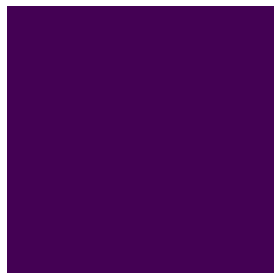

Disc: real loss: 0.794653 fake loss: 1.286358
GAN loss: 1.690261
Step 0 completed. Time took: 12 secs.
Begin step:  1
Disc: real loss: 1.002660 fake loss: 0.449371
GAN loss: 3.317447
Step 1 completed. Time took: 0 secs.
Begin step:  2
Disc: real loss: 0.655853 fake loss: 0.429812
GAN loss: 2.619977
Step 2 completed. Time took: 0 secs.
Begin step:  3
Disc: real loss: 0.762363 fake loss: 0.580351
GAN loss: 3.958386
Step 3 completed. Time took: 0 secs.
Begin step:  4
Disc: real loss: 0.439690 fake loss: 0.458744
GAN loss: 3.950262
Step 4 completed. Time took: 0 secs.
Begin step:  5
Disc: real loss: 0.762955 fake loss: 0.738623
GAN loss: 5.811075
Step 5 completed. Time took: 0 secs.
Begin step:  6
Disc: real loss: 1.265249 fake loss: 0.431409
GAN loss: 4.030601
Step 6 completed. Time took: 0 secs.
Begin step:  7
Disc: real loss: 0.650733 fake loss: 0.608589
GAN loss: 6.234176
Step 7 completed. Time took: 0 secs.
Begin step:  8
Disc: real loss: 0.618740 fake loss: 0.611336
GAN loss: 4.11264

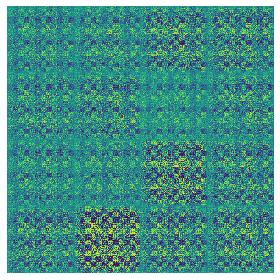

Disc: real loss: 0.669580 fake loss: 0.938226
GAN loss: 8.764326
Step 10 completed. Time took: 1 secs.
Begin step:  11
Disc: real loss: 0.565532 fake loss: 0.815776
GAN loss: 7.140962
Step 11 completed. Time took: 0 secs.
Begin step:  12
Disc: real loss: 0.708371 fake loss: 1.009175
GAN loss: 7.936586
Step 12 completed. Time took: 0 secs.
Begin step:  13
Disc: real loss: 0.688000 fake loss: 0.928392
GAN loss: 7.629621
Step 13 completed. Time took: 0 secs.
Begin step:  14
Disc: real loss: 0.594055 fake loss: 1.350709
GAN loss: 6.977686
Step 14 completed. Time took: 0 secs.
Begin step:  15
Disc: real loss: 0.741853 fake loss: 0.782830
GAN loss: 4.337618
Step 15 completed. Time took: 0 secs.
Begin step:  16
Disc: real loss: 0.518321 fake loss: 1.600512
GAN loss: 8.675503
Step 16 completed. Time took: 0 secs.
Begin step:  17
Disc: real loss: 0.825037 fake loss: 0.668236
GAN loss: 7.211539
Step 17 completed. Time took: 0 secs.
Begin step:  18
Disc: real loss: 0.468316 fake loss: 0.629789
GA

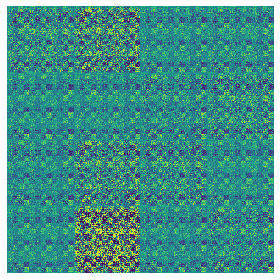

Disc: real loss: 0.574769 fake loss: 0.820042
GAN loss: 5.602284
Step 20 completed. Time took: 1 secs.
Begin step:  21
Disc: real loss: 0.579769 fake loss: 0.468441
GAN loss: 4.004792
Step 21 completed. Time took: 0 secs.
Begin step:  22
Disc: real loss: 0.656731 fake loss: 0.707501
GAN loss: 6.758778
Step 22 completed. Time took: 0 secs.
Begin step:  23
Disc: real loss: 1.888319 fake loss: 0.641537
GAN loss: 4.554609
Step 23 completed. Time took: 0 secs.
Begin step:  24
Disc: real loss: 1.438013 fake loss: 1.273390
GAN loss: 4.293067
Step 24 completed. Time took: 0 secs.
Begin step:  25
Disc: real loss: 1.541516 fake loss: 0.508079
GAN loss: 5.795267
Step 25 completed. Time took: 0 secs.
Begin step:  26
Disc: real loss: 1.644844 fake loss: 0.547201
GAN loss: 3.515036
Step 26 completed. Time took: 0 secs.
Begin step:  27
Disc: real loss: 1.173289 fake loss: 1.438651
GAN loss: 9.073236
Step 27 completed. Time took: 0 secs.
Begin step:  28
Disc: real loss: 0.648612 fake loss: 1.022708
GA

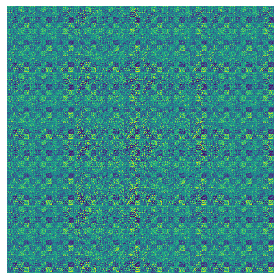

Disc: real loss: 0.833152 fake loss: 1.105581
GAN loss: 6.036792
Step 30 completed. Time took: 1 secs.
Begin step:  31
Disc: real loss: 0.489409 fake loss: 0.795200
GAN loss: 7.396195
Step 31 completed. Time took: 0 secs.
Begin step:  32
Disc: real loss: 0.657825 fake loss: 0.601293
GAN loss: 4.109759
Step 32 completed. Time took: 0 secs.
Begin step:  33
Disc: real loss: 0.838051 fake loss: 0.738083
GAN loss: 4.207012
Step 33 completed. Time took: 0 secs.
Begin step:  34
Disc: real loss: 0.884262 fake loss: 0.505491
GAN loss: 3.518457
Step 34 completed. Time took: 0 secs.
Begin step:  35
Disc: real loss: 0.582530 fake loss: 0.484872
GAN loss: 4.151110
Step 35 completed. Time took: 0 secs.
Begin step:  36
Disc: real loss: 0.577582 fake loss: 0.387652
GAN loss: 2.904672
Step 36 completed. Time took: 0 secs.
Begin step:  37
Disc: real loss: 0.551269 fake loss: 1.650495
GAN loss: 8.532698
Step 37 completed. Time took: 0 secs.
Begin step:  38
Disc: real loss: 1.954593 fake loss: 1.336620
GA

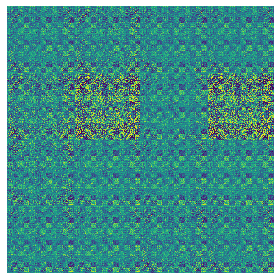

Disc: real loss: 0.816012 fake loss: 0.655865
GAN loss: 4.346476
Step 40 completed. Time took: 1 secs.
Begin step:  41
Disc: real loss: 0.839765 fake loss: 0.540939
GAN loss: 4.775845
Step 41 completed. Time took: 0 secs.
Begin step:  42
Disc: real loss: 0.405794 fake loss: 0.285198
GAN loss: 4.912362
Step 42 completed. Time took: 0 secs.
Begin step:  43
Disc: real loss: 0.470850 fake loss: 0.515495
GAN loss: 4.715892
Step 43 completed. Time took: 0 secs.
Begin step:  44
Disc: real loss: 0.685962 fake loss: 0.707889
GAN loss: 3.086973
Step 44 completed. Time took: 0 secs.
Begin step:  45
Disc: real loss: 0.633946 fake loss: 0.488347
GAN loss: 3.209136
Step 45 completed. Time took: 0 secs.
Begin step:  46
Disc: real loss: 0.519991 fake loss: 0.433556
GAN loss: 2.578958
Step 46 completed. Time took: 0 secs.
Begin step:  47
Disc: real loss: 0.455587 fake loss: 0.452074
GAN loss: 3.097890
Step 47 completed. Time took: 0 secs.
Begin step:  48
Disc: real loss: 0.410358 fake loss: 0.408880
GA

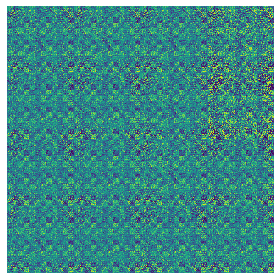

Disc: real loss: 0.496164 fake loss: 0.538278
GAN loss: 3.719555
Step 50 completed. Time took: 1 secs.
Begin step:  51
Disc: real loss: 0.777347 fake loss: 0.835703
GAN loss: 5.756789
Step 51 completed. Time took: 0 secs.
Begin step:  52
Disc: real loss: 0.393631 fake loss: 0.928049
GAN loss: 6.939819
Step 52 completed. Time took: 0 secs.
Begin step:  53
Disc: real loss: 0.616553 fake loss: 1.120847
GAN loss: 5.331392
Step 53 completed. Time took: 0 secs.
Begin step:  54
Disc: real loss: 0.547125 fake loss: 0.507192
GAN loss: 5.251616
Step 54 completed. Time took: 0 secs.
Begin step:  55
Disc: real loss: 0.549657 fake loss: 0.750079
GAN loss: 5.239703
Step 55 completed. Time took: 0 secs.
Begin step:  56
Disc: real loss: 0.570899 fake loss: 0.515192
GAN loss: 3.844228
Step 56 completed. Time took: 0 secs.
Begin step:  57
Disc: real loss: 0.567047 fake loss: 0.557262
GAN loss: 3.843746
Step 57 completed. Time took: 0 secs.
Begin step:  58
Disc: real loss: 0.423360 fake loss: 0.490760
GA

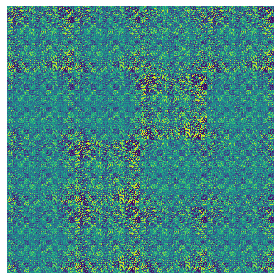

Disc: real loss: 4.230209 fake loss: 0.978287
GAN loss: 6.710027
Step 60 completed. Time took: 1 secs.
Begin step:  61
Disc: real loss: 0.793754 fake loss: 0.488785
GAN loss: 3.964112
Step 61 completed. Time took: 0 secs.
Begin step:  62
Disc: real loss: 0.785937 fake loss: 0.482713
GAN loss: 3.382533
Step 62 completed. Time took: 0 secs.
Begin step:  63
Disc: real loss: 0.557933 fake loss: 0.537133
GAN loss: 3.947999
Step 63 completed. Time took: 0 secs.
Begin step:  64
Disc: real loss: 0.673096 fake loss: 0.480842
GAN loss: 2.442694
Step 64 completed. Time took: 0 secs.
Begin step:  65
Disc: real loss: 0.669351 fake loss: 0.381631
GAN loss: 2.126886
Step 65 completed. Time took: 0 secs.
Begin step:  66
Disc: real loss: 0.402202 fake loss: 0.424269
GAN loss: 2.108106
Step 66 completed. Time took: 0 secs.
Begin step:  67
Disc: real loss: 0.395210 fake loss: 0.433626
GAN loss: 3.045557
Step 67 completed. Time took: 0 secs.
Begin step:  68
Disc: real loss: 1.221939 fake loss: 0.464290
GA

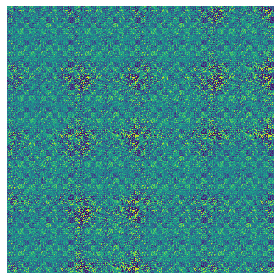

Disc: real loss: 0.388569 fake loss: 0.837205
GAN loss: 6.751264
Step 70 completed. Time took: 1 secs.
Begin step:  71
Disc: real loss: 0.836235 fake loss: 0.716958
GAN loss: 4.134923
Step 71 completed. Time took: 0 secs.
Begin step:  72
Disc: real loss: 0.687525 fake loss: 1.030576
GAN loss: 4.242514
Step 72 completed. Time took: 0 secs.
Begin step:  73
Disc: real loss: 0.555058 fake loss: 0.367611
GAN loss: 4.302107
Step 73 completed. Time took: 0 secs.
Begin step:  74
Disc: real loss: 0.372181 fake loss: 0.438203
GAN loss: 2.613722
Step 74 completed. Time took: 0 secs.
Begin step:  75
Disc: real loss: 0.292603 fake loss: 0.773199
GAN loss: 6.814748
Step 75 completed. Time took: 0 secs.
Begin step:  76
Disc: real loss: 1.058755 fake loss: 0.547080
GAN loss: 2.905046
Step 76 completed. Time took: 0 secs.
Begin step:  77
Disc: real loss: 0.506541 fake loss: 1.031263
GAN loss: 7.320960
Step 77 completed. Time took: 0 secs.
Begin step:  78
Disc: real loss: 0.593934 fake loss: 0.949656
GA

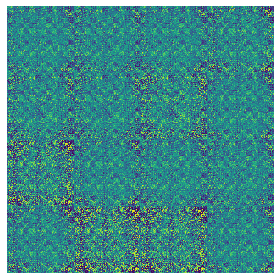

Disc: real loss: 0.491834 fake loss: 0.597778
GAN loss: 4.206818
Step 80 completed. Time took: 1 secs.
Begin step:  81
Disc: real loss: 0.404971 fake loss: 0.509556
GAN loss: 3.028877
Step 81 completed. Time took: 0 secs.
Begin step:  82
Disc: real loss: 0.409617 fake loss: 0.388371
GAN loss: 2.817508
Step 82 completed. Time took: 0 secs.
Begin step:  83
Disc: real loss: 0.342513 fake loss: 0.540545
GAN loss: 3.914212
Step 83 completed. Time took: 0 secs.
Begin step:  84
Disc: real loss: 0.775632 fake loss: 0.353755
GAN loss: 2.023067
Step 84 completed. Time took: 0 secs.
Begin step:  85
Disc: real loss: 0.365032 fake loss: 0.480423
GAN loss: 1.676262
Step 85 completed. Time took: 0 secs.
Begin step:  86
Disc: real loss: 0.424645 fake loss: 0.456120
GAN loss: 3.701993
Step 86 completed. Time took: 0 secs.
Begin step:  87
Disc: real loss: 0.940307 fake loss: 1.431625
GAN loss: 7.466879
Step 87 completed. Time took: 0 secs.
Begin step:  88
Disc: real loss: 0.572341 fake loss: 0.584686
GA

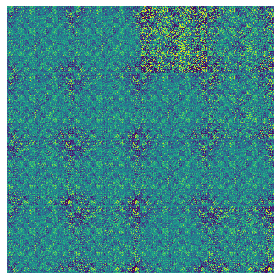

Disc: real loss: 0.355552 fake loss: 0.759461
GAN loss: 6.184594
Step 90 completed. Time took: 1 secs.
Begin step:  91
Disc: real loss: 0.425404 fake loss: 0.600140
GAN loss: 4.257079
Step 91 completed. Time took: 0 secs.
Begin step:  92
Disc: real loss: 0.395325 fake loss: 0.422339
GAN loss: 3.222688
Step 92 completed. Time took: 0 secs.
Begin step:  93
Disc: real loss: 0.345343 fake loss: 0.910702
GAN loss: 10.345833
Step 93 completed. Time took: 0 secs.
Begin step:  94
Disc: real loss: 1.490452 fake loss: 0.792560
GAN loss: 3.940446
Step 94 completed. Time took: 0 secs.
Begin step:  95
Disc: real loss: 0.562633 fake loss: 0.933039
GAN loss: 6.887819
Step 95 completed. Time took: 0 secs.
Begin step:  96
Disc: real loss: 0.482634 fake loss: 0.561840
GAN loss: 6.278543
Step 96 completed. Time took: 0 secs.
Begin step:  97
Disc: real loss: 0.566193 fake loss: 0.379897
GAN loss: 3.569540
Step 97 completed. Time took: 0 secs.
Begin step:  98
Disc: real loss: 0.375312 fake loss: 0.862605
G

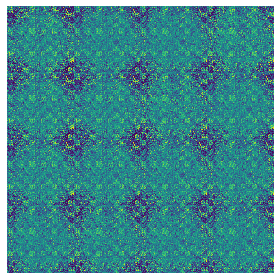

Disc: real loss: 0.454270 fake loss: 0.587089
GAN loss: 5.828386
Step 100 completed. Time took: 1 secs.
Begin step:  101
Disc: real loss: 0.528039 fake loss: 0.422665
GAN loss: 2.284907
Step 101 completed. Time took: 0 secs.
Begin step:  102
Disc: real loss: 0.272790 fake loss: 1.978419
GAN loss: 12.626188
Step 102 completed. Time took: 0 secs.
Begin step:  103
Disc: real loss: 2.295156 fake loss: 0.936461
GAN loss: 7.968745
Step 103 completed. Time took: 0 secs.
Begin step:  104
Disc: real loss: 0.397713 fake loss: 0.479742
GAN loss: 2.941161
Step 104 completed. Time took: 0 secs.
Begin step:  105
Disc: real loss: 0.356960 fake loss: 0.802343
GAN loss: 5.047974
Step 105 completed. Time took: 0 secs.
Begin step:  106
Disc: real loss: 0.498996 fake loss: 0.511544
GAN loss: 3.327880
Step 106 completed. Time took: 0 secs.
Begin step:  107
Disc: real loss: 0.604104 fake loss: 1.442883
GAN loss: 7.610897
Step 107 completed. Time took: 0 secs.
Begin step:  108
Disc: real loss: 0.510230 fake 

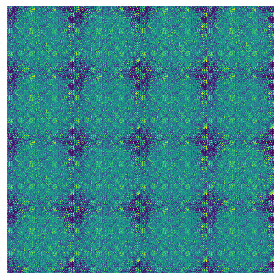

Disc: real loss: 0.520546 fake loss: 3.109576
GAN loss: 10.435610
Step 110 completed. Time took: 1 secs.
Begin step:  111
Disc: real loss: 1.266410 fake loss: 0.931156
GAN loss: 8.975468
Step 111 completed. Time took: 0 secs.
Begin step:  112
Disc: real loss: 0.333655 fake loss: 0.675448
GAN loss: 5.082428
Step 112 completed. Time took: 0 secs.
Begin step:  113
Disc: real loss: 0.396966 fake loss: 0.423530
GAN loss: 2.189273
Step 113 completed. Time took: 0 secs.
Begin step:  114
Disc: real loss: 0.437545 fake loss: 0.889100
GAN loss: 3.669873
Step 114 completed. Time took: 0 secs.
Begin step:  115
Disc: real loss: 0.392255 fake loss: 0.528152
GAN loss: 4.003787
Step 115 completed. Time took: 0 secs.
Begin step:  116
Disc: real loss: 0.369375 fake loss: 0.699320
GAN loss: 2.478889
Step 116 completed. Time took: 0 secs.
Begin step:  117
Disc: real loss: 0.608065 fake loss: 0.588287
GAN loss: 2.271504
Step 117 completed. Time took: 0 secs.
Begin step:  118
Disc: real loss: 0.329167 fake 

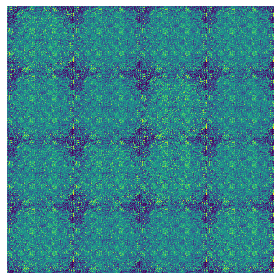

Disc: real loss: 0.395696 fake loss: 0.558584
GAN loss: 3.383495
Step 120 completed. Time took: 1 secs.
Begin step:  121
Disc: real loss: 0.508152 fake loss: 0.331253
GAN loss: 1.970179
Step 121 completed. Time took: 0 secs.
Begin step:  122
Disc: real loss: 0.355407 fake loss: 1.171720
GAN loss: 8.639440
Step 122 completed. Time took: 0 secs.
Begin step:  123
Disc: real loss: 1.670524 fake loss: 0.636722
GAN loss: 5.102542
Step 123 completed. Time took: 0 secs.
Begin step:  124
Disc: real loss: 0.450331 fake loss: 0.329672
GAN loss: 2.073990
Step 124 completed. Time took: 0 secs.
Begin step:  125
Disc: real loss: 0.455063 fake loss: 0.739217
GAN loss: 4.353882
Step 125 completed. Time took: 0 secs.
Begin step:  126
Disc: real loss: 0.372732 fake loss: 0.522083
GAN loss: 4.313321
Step 126 completed. Time took: 0 secs.
Begin step:  127
Disc: real loss: 0.628551 fake loss: 0.382802
GAN loss: 2.476384
Step 127 completed. Time took: 0 secs.
Begin step:  128
Disc: real loss: 0.389983 fake l

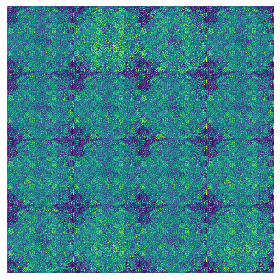

Disc: real loss: 0.352836 fake loss: 0.435990
GAN loss: 2.813280
Step 130 completed. Time took: 1 secs.
Begin step:  131
Disc: real loss: 0.358477 fake loss: 0.688435
GAN loss: 4.961917
Step 131 completed. Time took: 0 secs.
Begin step:  132
Disc: real loss: 1.106450 fake loss: 0.506818
GAN loss: 1.591391
Step 132 completed. Time took: 0 secs.
Begin step:  133
Disc: real loss: 0.400244 fake loss: 1.847996
GAN loss: 7.750647
Step 133 completed. Time took: 0 secs.
Begin step:  134
Disc: real loss: 1.188013 fake loss: 0.849842
GAN loss: 6.109142
Step 134 completed. Time took: 0 secs.
Begin step:  135
Disc: real loss: 0.435667 fake loss: 0.472834
GAN loss: 3.355543
Step 135 completed. Time took: 0 secs.
Begin step:  136
Disc: real loss: 0.374157 fake loss: 0.358078
GAN loss: 2.764306
Step 136 completed. Time took: 0 secs.
Begin step:  137
Disc: real loss: 0.467812 fake loss: 0.376434
GAN loss: 2.571361
Step 137 completed. Time took: 0 secs.
Begin step:  138
Disc: real loss: 0.328224 fake l

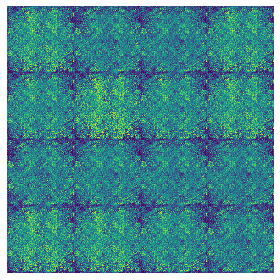

Disc: real loss: 0.422443 fake loss: 0.363155
GAN loss: 2.089221
Step 140 completed. Time took: 1 secs.
Begin step:  141
Disc: real loss: 0.390575 fake loss: 0.537800
GAN loss: 3.736260
Step 141 completed. Time took: 0 secs.
Begin step:  142
Disc: real loss: 0.659641 fake loss: 0.311065
GAN loss: 2.592380
Step 142 completed. Time took: 0 secs.
Begin step:  143
Disc: real loss: 0.374532 fake loss: 1.066582
GAN loss: 7.702250
Step 143 completed. Time took: 0 secs.
Begin step:  144
Disc: real loss: 0.562137 fake loss: 0.860061
GAN loss: 7.105230
Step 144 completed. Time took: 0 secs.
Begin step:  145
Disc: real loss: 0.413269 fake loss: 0.541538
GAN loss: 3.982259
Step 145 completed. Time took: 0 secs.
Begin step:  146
Disc: real loss: 0.513704 fake loss: 0.428255
GAN loss: 2.654252
Step 146 completed. Time took: 0 secs.
Begin step:  147
Disc: real loss: 0.486788 fake loss: 0.336976
GAN loss: 2.574347
Step 147 completed. Time took: 0 secs.
Begin step:  148
Disc: real loss: 0.347648 fake l

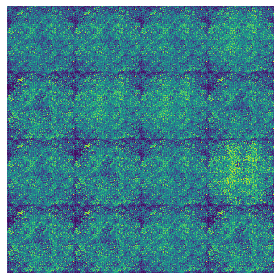

Disc: real loss: 0.282875 fake loss: 0.429478
GAN loss: 4.090602
Step 150 completed. Time took: 1 secs.
Begin step:  151
Disc: real loss: 0.566315 fake loss: 0.489668
GAN loss: 2.715837
Step 151 completed. Time took: 0 secs.
Begin step:  152
Disc: real loss: 0.439528 fake loss: 0.350380
GAN loss: 3.045842
Step 152 completed. Time took: 0 secs.
Begin step:  153
Disc: real loss: 0.475348 fake loss: 0.414681
GAN loss: 3.037717
Step 153 completed. Time took: 0 secs.
Begin step:  154
Disc: real loss: 0.578728 fake loss: 0.415650
GAN loss: 3.050813
Step 154 completed. Time took: 0 secs.
Begin step:  155
Disc: real loss: 0.392539 fake loss: 0.353546
GAN loss: 2.621033
Step 155 completed. Time took: 0 secs.
Begin step:  156
Disc: real loss: 0.345384 fake loss: 0.354746
GAN loss: 2.074301
Step 156 completed. Time took: 0 secs.
Begin step:  157
Disc: real loss: 0.360821 fake loss: 0.795574
GAN loss: 9.240924
Step 157 completed. Time took: 0 secs.
Begin step:  158
Disc: real loss: 3.534571 fake l

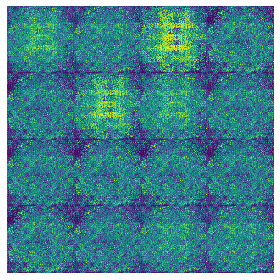

Disc: real loss: 0.364679 fake loss: 0.407274
GAN loss: 2.166234
Step 160 completed. Time took: 1 secs.
Begin step:  161
Disc: real loss: 0.404546 fake loss: 0.396618
GAN loss: 2.090987
Step 161 completed. Time took: 0 secs.
Begin step:  162
Disc: real loss: 0.655636 fake loss: 1.305406
GAN loss: 2.608202
Step 162 completed. Time took: 0 secs.
Begin step:  163
Disc: real loss: 0.523849 fake loss: 0.403792
GAN loss: 2.950691
Step 163 completed. Time took: 0 secs.
Begin step:  164
Disc: real loss: 0.392362 fake loss: 0.305369
GAN loss: 2.485617
Step 164 completed. Time took: 0 secs.
Begin step:  165
Disc: real loss: 0.370102 fake loss: 0.380499
GAN loss: 1.690561
Step 165 completed. Time took: 0 secs.
Begin step:  166
Disc: real loss: 0.318350 fake loss: 0.510145
GAN loss: 2.968956
Step 166 completed. Time took: 0 secs.
Begin step:  167
Disc: real loss: 0.592749 fake loss: 0.372523
GAN loss: 1.983184
Step 167 completed. Time took: 0 secs.
Begin step:  168
Disc: real loss: 0.338817 fake l

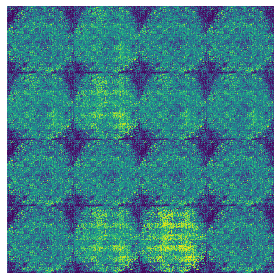

Disc: real loss: 0.257946 fake loss: 0.453814
GAN loss: 2.316715
Step 170 completed. Time took: 1 secs.
Begin step:  171
Disc: real loss: 0.382513 fake loss: 0.455291
GAN loss: 2.460553
Step 171 completed. Time took: 0 secs.
Begin step:  172
Disc: real loss: 0.412318 fake loss: 0.331560
GAN loss: 2.384322
Step 172 completed. Time took: 0 secs.
Begin step:  173
Disc: real loss: 0.809144 fake loss: 2.246281
GAN loss: 5.978953
Step 173 completed. Time took: 0 secs.
Begin step:  174
Disc: real loss: 1.412164 fake loss: 0.483654
GAN loss: 3.787341
Step 174 completed. Time took: 0 secs.
Begin step:  175
Disc: real loss: 0.330447 fake loss: 0.409334
GAN loss: 2.003253
Step 175 completed. Time took: 0 secs.
Begin step:  176
Disc: real loss: 0.335585 fake loss: 0.426919
GAN loss: 2.712541
Step 176 completed. Time took: 0 secs.
Begin step:  177
Disc: real loss: 0.375995 fake loss: 0.354503
GAN loss: 2.837406
Step 177 completed. Time took: 0 secs.
Begin step:  178
Disc: real loss: 0.347574 fake l

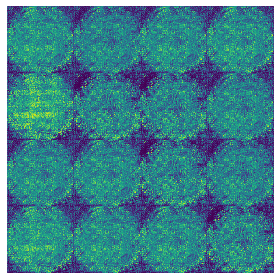

Disc: real loss: 0.525983 fake loss: 0.345702
GAN loss: 2.621532
Step 180 completed. Time took: 1 secs.
Begin step:  181
Disc: real loss: 0.334292 fake loss: 0.337347
GAN loss: 1.579919
Step 181 completed. Time took: 0 secs.
Begin step:  182
Disc: real loss: 0.359613 fake loss: 0.358499
GAN loss: 1.772169
Step 182 completed. Time took: 0 secs.
Begin step:  183
Disc: real loss: 0.404591 fake loss: 0.349419
GAN loss: 2.026609
Step 183 completed. Time took: 0 secs.
Begin step:  184
Disc: real loss: 0.524496 fake loss: 0.826581
GAN loss: 4.528507
Step 184 completed. Time took: 0 secs.
Begin step:  185
Disc: real loss: 0.633779 fake loss: 0.441766
GAN loss: 2.080199
Step 185 completed. Time took: 0 secs.
Begin step:  186
Disc: real loss: 0.447501 fake loss: 0.364921
GAN loss: 1.967759
Step 186 completed. Time took: 0 secs.
Begin step:  187
Disc: real loss: 0.293531 fake loss: 0.372914
GAN loss: 1.808600
Step 187 completed. Time took: 0 secs.
Begin step:  188
Disc: real loss: 0.332676 fake l

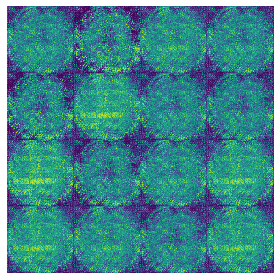

Disc: real loss: 0.356388 fake loss: 0.328917
GAN loss: 1.933975
Step 190 completed. Time took: 1 secs.
Begin step:  191
Disc: real loss: 0.316988 fake loss: 0.358323
GAN loss: 2.372237
Step 191 completed. Time took: 0 secs.
Begin step:  192
Disc: real loss: 0.551099 fake loss: 1.249996
GAN loss: 6.011527
Step 192 completed. Time took: 0 secs.
Begin step:  193
Disc: real loss: 1.385192 fake loss: 0.451981
GAN loss: 3.063329
Step 193 completed. Time took: 0 secs.
Begin step:  194
Disc: real loss: 0.515433 fake loss: 0.432300
GAN loss: 2.184543
Step 194 completed. Time took: 0 secs.
Begin step:  195
Disc: real loss: 0.460933 fake loss: 0.314251
GAN loss: 2.321009
Step 195 completed. Time took: 0 secs.
Begin step:  196
Disc: real loss: 0.387692 fake loss: 0.391594
GAN loss: 1.558675
Step 196 completed. Time took: 0 secs.
Begin step:  197
Disc: real loss: 0.395234 fake loss: 0.736399
GAN loss: 3.366708
Step 197 completed. Time took: 0 secs.
Begin step:  198
Disc: real loss: 0.675234 fake l

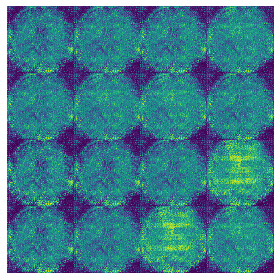

Disc: real loss: 0.415569 fake loss: 0.296816
GAN loss: 3.072616
Step 200 completed. Time took: 2 secs.
Begin step:  201
Disc: real loss: 0.315091 fake loss: 0.320463
GAN loss: 2.176147
Step 201 completed. Time took: 0 secs.
Begin step:  202
Disc: real loss: 0.627570 fake loss: 1.272212
GAN loss: 7.836011
Step 202 completed. Time took: 0 secs.
Begin step:  203
Disc: real loss: 1.941313 fake loss: 0.559812
GAN loss: 3.413078
Step 203 completed. Time took: 0 secs.
Begin step:  204
Disc: real loss: 0.591120 fake loss: 0.487120
GAN loss: 2.787051
Step 204 completed. Time took: 0 secs.
Begin step:  205
Disc: real loss: 0.356156 fake loss: 0.340993
GAN loss: 2.555821
Step 205 completed. Time took: 0 secs.
Begin step:  206
Disc: real loss: 0.468490 fake loss: 0.741083
GAN loss: 4.970984
Step 206 completed. Time took: 0 secs.
Begin step:  207
Disc: real loss: 0.870701 fake loss: 0.385346
GAN loss: 2.202214
Step 207 completed. Time took: 0 secs.
Begin step:  208
Disc: real loss: 0.350482 fake l

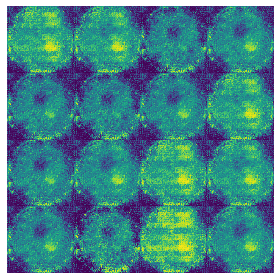

Disc: real loss: 0.415808 fake loss: 0.381529
GAN loss: 1.774078
Step 210 completed. Time took: 1 secs.
Begin step:  211
Disc: real loss: 0.378839 fake loss: 0.778088
GAN loss: 6.521667
Step 211 completed. Time took: 0 secs.
Begin step:  212
Disc: real loss: 1.786667 fake loss: 0.427990
GAN loss: 1.720610
Step 212 completed. Time took: 0 secs.
Begin step:  213
Disc: real loss: 0.363275 fake loss: 0.820755
GAN loss: 3.112042
Step 213 completed. Time took: 0 secs.
Begin step:  214
Disc: real loss: 0.373839 fake loss: 0.446792
GAN loss: 3.227910
Step 214 completed. Time took: 0 secs.
Begin step:  215
Disc: real loss: 0.535701 fake loss: 0.314915
GAN loss: 1.705039
Step 215 completed. Time took: 0 secs.
Begin step:  216
Disc: real loss: 0.363978 fake loss: 0.566310
GAN loss: 2.067199
Step 216 completed. Time took: 0 secs.
Begin step:  217
Disc: real loss: 0.467122 fake loss: 0.369795
GAN loss: 2.681705
Step 217 completed. Time took: 0 secs.
Begin step:  218
Disc: real loss: 0.384980 fake l

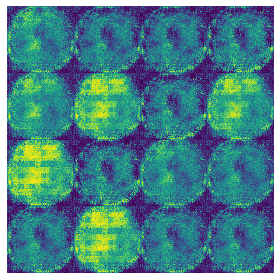

Disc: real loss: 0.349007 fake loss: 0.363630
GAN loss: 2.053573
Step 220 completed. Time took: 1 secs.
Begin step:  221
Disc: real loss: 0.371567 fake loss: 0.361593
GAN loss: 2.676001
Step 221 completed. Time took: 0 secs.
Begin step:  222
Disc: real loss: 0.498794 fake loss: 0.828101
GAN loss: 5.068982
Step 222 completed. Time took: 0 secs.
Begin step:  223
Disc: real loss: 0.753852 fake loss: 0.463252
GAN loss: 3.472879
Step 223 completed. Time took: 0 secs.
Begin step:  224
Disc: real loss: 0.308218 fake loss: 0.455189
GAN loss: 2.852986
Step 224 completed. Time took: 0 secs.
Begin step:  225
Disc: real loss: 0.428065 fake loss: 0.341783
GAN loss: 2.597260
Step 225 completed. Time took: 0 secs.
Begin step:  226
Disc: real loss: 0.408801 fake loss: 0.411223
GAN loss: 2.287891
Step 226 completed. Time took: 0 secs.
Begin step:  227
Disc: real loss: 0.409854 fake loss: 0.457488
GAN loss: 2.722251
Step 227 completed. Time took: 0 secs.
Begin step:  228
Disc: real loss: 0.407199 fake l

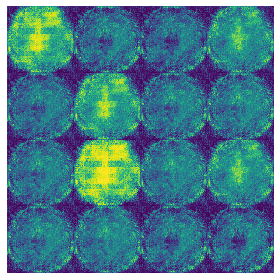

Disc: real loss: 0.376538 fake loss: 0.375909
GAN loss: 2.127669
Step 230 completed. Time took: 1 secs.
Begin step:  231
Disc: real loss: 0.510692 fake loss: 1.201164
GAN loss: 6.410666
Step 231 completed. Time took: 0 secs.
Begin step:  232
Disc: real loss: 2.675324 fake loss: 0.379477
GAN loss: 2.596756
Step 232 completed. Time took: 0 secs.
Begin step:  233
Disc: real loss: 0.389882 fake loss: 0.469973
GAN loss: 2.096886
Step 233 completed. Time took: 0 secs.
Begin step:  234
Disc: real loss: 0.372082 fake loss: 0.326692
GAN loss: 2.601956
Step 234 completed. Time took: 0 secs.
Begin step:  235
Disc: real loss: 0.512537 fake loss: 0.445478
GAN loss: 1.493584
Step 235 completed. Time took: 0 secs.
Begin step:  236
Disc: real loss: 0.325632 fake loss: 0.327699
GAN loss: 2.126754
Step 236 completed. Time took: 0 secs.
Begin step:  237
Disc: real loss: 0.323479 fake loss: 0.320904
GAN loss: 2.046097
Step 237 completed. Time took: 0 secs.
Begin step:  238
Disc: real loss: 0.370999 fake l

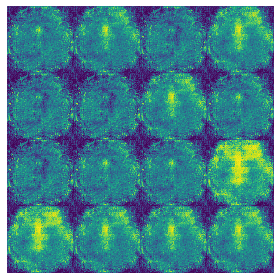

Disc: real loss: 0.399646 fake loss: 0.432898
GAN loss: 1.692012
Step 240 completed. Time took: 1 secs.
Begin step:  241
Disc: real loss: 0.381490 fake loss: 0.372527
GAN loss: 1.618254
Step 241 completed. Time took: 0 secs.
Begin step:  242
Disc: real loss: 0.349157 fake loss: 0.408912
GAN loss: 2.306544
Step 242 completed. Time took: 0 secs.
Begin step:  243
Disc: real loss: 0.465196 fake loss: 0.376046
GAN loss: 1.924314
Step 243 completed. Time took: 0 secs.
Begin step:  244
Disc: real loss: 0.355562 fake loss: 0.581607
GAN loss: 3.591716
Step 244 completed. Time took: 0 secs.
Begin step:  245
Disc: real loss: 0.818079 fake loss: 0.357109
GAN loss: 2.416033
Step 245 completed. Time took: 0 secs.
Begin step:  246
Disc: real loss: 0.422853 fake loss: 0.422544
GAN loss: 2.163450
Step 246 completed. Time took: 0 secs.
Begin step:  247
Disc: real loss: 0.314612 fake loss: 0.399751
GAN loss: 2.530743
Step 247 completed. Time took: 0 secs.
Begin step:  248
Disc: real loss: 0.442015 fake l

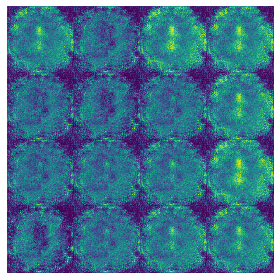

Disc: real loss: 0.569284 fake loss: 0.406732
GAN loss: 1.188032
Step 250 completed. Time took: 1 secs.
Begin step:  251
Disc: real loss: 0.369160 fake loss: 0.342011
GAN loss: 2.188260
Step 251 completed. Time took: 0 secs.
Begin step:  252
Disc: real loss: 0.341849 fake loss: 0.378780
GAN loss: 3.086388
Step 252 completed. Time took: 0 secs.
Begin step:  253
Disc: real loss: 0.529391 fake loss: 0.515407
GAN loss: 2.652725
Step 253 completed. Time took: 0 secs.
Begin step:  254
Disc: real loss: 0.391516 fake loss: 0.352494
GAN loss: 3.192634
Step 254 completed. Time took: 0 secs.
Begin step:  255
Disc: real loss: 0.389018 fake loss: 0.488254
GAN loss: 2.758204
Step 255 completed. Time took: 0 secs.
Begin step:  256
Disc: real loss: 0.347787 fake loss: 0.439415
GAN loss: 2.488050
Step 256 completed. Time took: 0 secs.
Begin step:  257
Disc: real loss: 0.380736 fake loss: 0.316909
GAN loss: 2.362548
Step 257 completed. Time took: 0 secs.
Begin step:  258
Disc: real loss: 0.387961 fake l

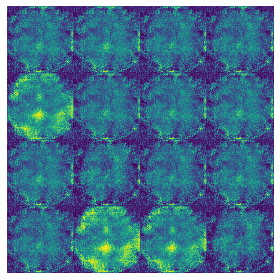

Disc: real loss: 0.574824 fake loss: 1.265978
GAN loss: 5.485483
Step 260 completed. Time took: 1 secs.
Begin step:  261
Disc: real loss: 1.069615 fake loss: 0.395212
GAN loss: 4.293689
Step 261 completed. Time took: 0 secs.
Begin step:  262
Disc: real loss: 0.460062 fake loss: 0.254539
GAN loss: 2.433908
Step 262 completed. Time took: 0 secs.
Begin step:  263
Disc: real loss: 0.383328 fake loss: 0.244257
GAN loss: 2.337561
Step 263 completed. Time took: 0 secs.
Begin step:  264
Disc: real loss: 0.382046 fake loss: 0.343141
GAN loss: 1.990800
Step 264 completed. Time took: 0 secs.
Begin step:  265
Disc: real loss: 0.478623 fake loss: 0.332225
GAN loss: 2.089787
Step 265 completed. Time took: 0 secs.
Begin step:  266
Disc: real loss: 0.487349 fake loss: 0.511450
GAN loss: 1.446241
Step 266 completed. Time took: 0 secs.
Begin step:  267
Disc: real loss: 0.393894 fake loss: 0.357233
GAN loss: 2.242682
Step 267 completed. Time took: 0 secs.
Begin step:  268
Disc: real loss: 0.568284 fake l

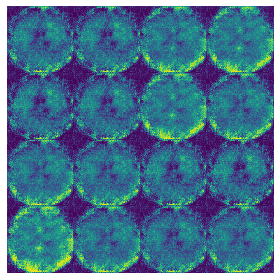

Disc: real loss: 0.350900 fake loss: 0.332966
GAN loss: 3.165248
Step 270 completed. Time took: 1 secs.
Begin step:  271
Disc: real loss: 0.439248 fake loss: 0.542372
GAN loss: 7.152987
Step 271 completed. Time took: 0 secs.
Begin step:  272
Disc: real loss: 0.918232 fake loss: 0.355195
GAN loss: 0.966377
Step 272 completed. Time took: 0 secs.
Begin step:  273
Disc: real loss: 0.491640 fake loss: 0.712329
GAN loss: 4.581394
Step 273 completed. Time took: 0 secs.
Begin step:  274
Disc: real loss: 0.519925 fake loss: 0.470304
GAN loss: 3.223867
Step 274 completed. Time took: 0 secs.
Begin step:  275
Disc: real loss: 0.444698 fake loss: 0.874870
GAN loss: 7.485414
Step 275 completed. Time took: 0 secs.
Begin step:  276
Disc: real loss: 1.740637 fake loss: 0.581990
GAN loss: 3.126055
Step 276 completed. Time took: 0 secs.
Begin step:  277
Disc: real loss: 0.599728 fake loss: 0.446762
GAN loss: 2.967667
Step 277 completed. Time took: 0 secs.
Begin step:  278
Disc: real loss: 0.371910 fake l

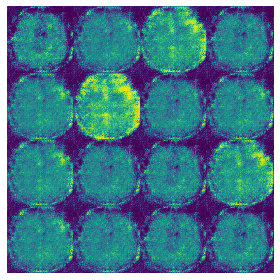

Disc: real loss: 0.392856 fake loss: 0.413003
GAN loss: 2.988261
Step 280 completed. Time took: 1 secs.
Begin step:  281
Disc: real loss: 0.472714 fake loss: 0.338518
GAN loss: 2.267267
Step 281 completed. Time took: 0 secs.
Begin step:  282
Disc: real loss: 0.361002 fake loss: 0.364652
GAN loss: 2.511557
Step 282 completed. Time took: 0 secs.
Begin step:  283
Disc: real loss: 0.377321 fake loss: 0.393995
GAN loss: 2.873935
Step 283 completed. Time took: 0 secs.
Begin step:  284
Disc: real loss: 0.501176 fake loss: 0.301518
GAN loss: 1.723628
Step 284 completed. Time took: 0 secs.
Begin step:  285
Disc: real loss: 0.352379 fake loss: 0.564284
GAN loss: 5.165086
Step 285 completed. Time took: 0 secs.
Begin step:  286
Disc: real loss: 0.890909 fake loss: 0.291605
GAN loss: 2.234287
Step 286 completed. Time took: 0 secs.
Begin step:  287
Disc: real loss: 0.365236 fake loss: 0.386746
GAN loss: 2.039514
Step 287 completed. Time took: 0 secs.
Begin step:  288
Disc: real loss: 0.384467 fake l

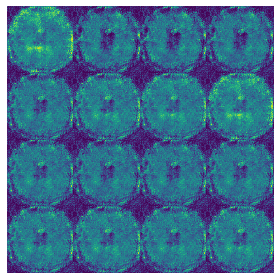

Disc: real loss: 0.385500 fake loss: 0.388449
GAN loss: 1.173154
Step 290 completed. Time took: 1 secs.
Begin step:  291
Disc: real loss: 0.387753 fake loss: 0.837880
GAN loss: 3.051254
Step 291 completed. Time took: 0 secs.
Begin step:  292
Disc: real loss: 0.545646 fake loss: 0.373518
GAN loss: 2.752693
Step 292 completed. Time took: 0 secs.
Begin step:  293
Disc: real loss: 0.463391 fake loss: 0.460862
GAN loss: 2.388649
Step 293 completed. Time took: 0 secs.
Begin step:  294
Disc: real loss: 0.391658 fake loss: 0.315997
GAN loss: 2.845052
Step 294 completed. Time took: 0 secs.
Begin step:  295
Disc: real loss: 0.314068 fake loss: 0.386958
GAN loss: 2.684081
Step 295 completed. Time took: 0 secs.
Begin step:  296
Disc: real loss: 0.375043 fake loss: 0.311607
GAN loss: 1.940642
Step 296 completed. Time took: 0 secs.
Begin step:  297
Disc: real loss: 0.641198 fake loss: 1.354937
GAN loss: 9.560822
Step 297 completed. Time took: 0 secs.
Begin step:  298
Disc: real loss: 1.595548 fake l

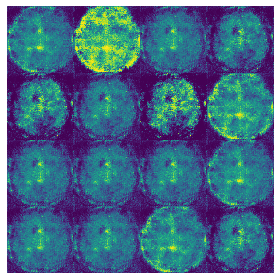

Disc: real loss: 0.298514 fake loss: 0.327509
GAN loss: 2.969498
Step 300 completed. Time took: 1 secs.
Begin step:  301
Disc: real loss: 0.530250 fake loss: 0.376326
GAN loss: 2.052799
Step 301 completed. Time took: 0 secs.
Begin step:  302
Disc: real loss: 0.375504 fake loss: 0.283503
GAN loss: 2.033564
Step 302 completed. Time took: 0 secs.
Begin step:  303
Disc: real loss: 0.334891 fake loss: 0.374465
GAN loss: 1.692688
Step 303 completed. Time took: 0 secs.
Begin step:  304
Disc: real loss: 0.334916 fake loss: 0.451509
GAN loss: 2.369756
Step 304 completed. Time took: 0 secs.
Begin step:  305
Disc: real loss: 0.521241 fake loss: 0.352836
GAN loss: 2.233875
Step 305 completed. Time took: 0 secs.
Begin step:  306
Disc: real loss: 0.353129 fake loss: 0.378566
GAN loss: 1.702348
Step 306 completed. Time took: 0 secs.
Begin step:  307
Disc: real loss: 0.386170 fake loss: 0.392425
GAN loss: 1.360063
Step 307 completed. Time took: 0 secs.
Begin step:  308
Disc: real loss: 0.373762 fake l

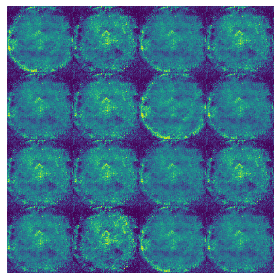

Disc: real loss: 0.663104 fake loss: 0.430067
GAN loss: 1.108220
Step 310 completed. Time took: 1 secs.
Begin step:  311
Disc: real loss: 0.387619 fake loss: 0.391405
GAN loss: 1.985339
Step 311 completed. Time took: 0 secs.
Begin step:  312
Disc: real loss: 0.404623 fake loss: 0.349499
GAN loss: 2.378791
Step 312 completed. Time took: 0 secs.
Begin step:  313
Disc: real loss: 0.323192 fake loss: 0.326253
GAN loss: 2.523163
Step 313 completed. Time took: 0 secs.
Begin step:  314
Disc: real loss: 0.680960 fake loss: 1.064080
GAN loss: 4.567419
Step 314 completed. Time took: 0 secs.
Begin step:  315
Disc: real loss: 0.912195 fake loss: 0.410431
GAN loss: 2.312307
Step 315 completed. Time took: 0 secs.
Begin step:  316
Disc: real loss: 0.381657 fake loss: 0.446371
GAN loss: 2.353959
Step 316 completed. Time took: 0 secs.
Begin step:  317
Disc: real loss: 0.352460 fake loss: 0.349467
GAN loss: 2.705468
Step 317 completed. Time took: 0 secs.
Begin step:  318
Disc: real loss: 0.402878 fake l

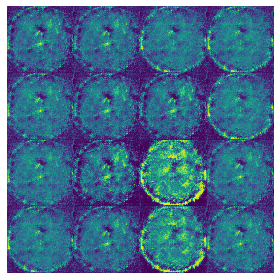

Disc: real loss: 0.404587 fake loss: 0.344838
GAN loss: 2.732133
Step 320 completed. Time took: 1 secs.
Begin step:  321
Disc: real loss: 0.405323 fake loss: 0.350858
GAN loss: 1.815953
Step 321 completed. Time took: 0 secs.
Begin step:  322
Disc: real loss: 0.399545 fake loss: 0.707332
GAN loss: 4.115197
Step 322 completed. Time took: 0 secs.
Begin step:  323
Disc: real loss: 0.751359 fake loss: 0.328998
GAN loss: 1.968928
Step 323 completed. Time took: 0 secs.
Begin step:  324
Disc: real loss: 0.589839 fake loss: 0.427938
GAN loss: 2.350883
Step 324 completed. Time took: 0 secs.
Begin step:  325
Disc: real loss: 0.393989 fake loss: 0.400385
GAN loss: 1.154995
Step 325 completed. Time took: 0 secs.
Begin step:  326
Disc: real loss: 0.368679 fake loss: 0.417108
GAN loss: 0.886175
Step 326 completed. Time took: 0 secs.
Begin step:  327
Disc: real loss: 0.351742 fake loss: 0.959955
GAN loss: 6.058187
Step 327 completed. Time took: 0 secs.
Begin step:  328
Disc: real loss: 1.943789 fake l

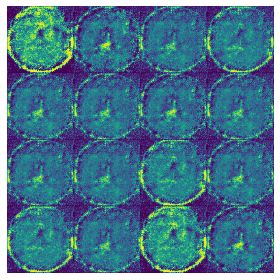

Disc: real loss: 0.494299 fake loss: 0.385007
GAN loss: 1.619425
Step 330 completed. Time took: 1 secs.
Begin step:  331
Disc: real loss: 0.327372 fake loss: 0.399321
GAN loss: 3.426274
Step 331 completed. Time took: 0 secs.
Begin step:  332
Disc: real loss: 0.426884 fake loss: 0.399660
GAN loss: 3.022760
Step 332 completed. Time took: 0 secs.
Begin step:  333
Disc: real loss: 0.918187 fake loss: 1.908098
GAN loss: 10.918067
Step 333 completed. Time took: 0 secs.
Begin step:  334
Disc: real loss: 1.988428 fake loss: 0.936123
GAN loss: 5.511944
Step 334 completed. Time took: 0 secs.
Begin step:  335
Disc: real loss: 0.400297 fake loss: 0.586291
GAN loss: 2.256453
Step 335 completed. Time took: 0 secs.
Begin step:  336
Disc: real loss: 0.474474 fake loss: 0.474091
GAN loss: 2.467143
Step 336 completed. Time took: 0 secs.
Begin step:  337
Disc: real loss: 0.381095 fake loss: 0.339897
GAN loss: 2.047065
Step 337 completed. Time took: 0 secs.
Begin step:  338
Disc: real loss: 0.286164 fake 

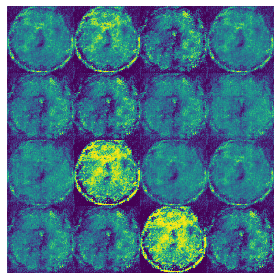

Disc: real loss: 0.386097 fake loss: 0.443450
GAN loss: 1.584098
Step 340 completed. Time took: 1 secs.
Begin step:  341
Disc: real loss: 0.418751 fake loss: 0.451013
GAN loss: 3.048268
Step 341 completed. Time took: 0 secs.
Begin step:  342
Disc: real loss: 0.818325 fake loss: 0.411948
GAN loss: 1.252428
Step 342 completed. Time took: 0 secs.
Begin step:  343
Disc: real loss: 0.351897 fake loss: 0.401429
GAN loss: 2.330297
Step 343 completed. Time took: 0 secs.
Begin step:  344
Disc: real loss: 0.275331 fake loss: 0.356811
GAN loss: 2.809444
Step 344 completed. Time took: 0 secs.
Begin step:  345
Disc: real loss: 0.347872 fake loss: 0.362632
GAN loss: 1.755939
Step 345 completed. Time took: 0 secs.
Begin step:  346
Disc: real loss: 0.342479 fake loss: 0.408476
GAN loss: 2.052405
Step 346 completed. Time took: 0 secs.
Begin step:  347
Disc: real loss: 0.683732 fake loss: 0.483771
GAN loss: 0.553161
Step 347 completed. Time took: 0 secs.
Begin step:  348
Disc: real loss: 0.415615 fake l

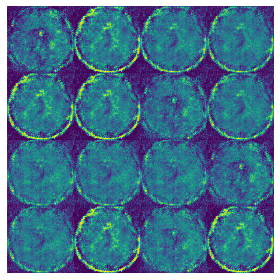

Disc: real loss: 1.268131 fake loss: 0.386621
GAN loss: 1.929232
Step 350 completed. Time took: 1 secs.
Begin step:  351
Disc: real loss: 0.407219 fake loss: 0.369423
GAN loss: 3.833001
Step 351 completed. Time took: 0 secs.
Begin step:  352
Disc: real loss: 0.338274 fake loss: 0.359579
GAN loss: 2.285350
Step 352 completed. Time took: 0 secs.
Begin step:  353
Disc: real loss: 0.360343 fake loss: 0.497409
GAN loss: 3.002615
Step 353 completed. Time took: 0 secs.
Begin step:  354
Disc: real loss: 0.539582 fake loss: 0.410191
GAN loss: 2.260626
Step 354 completed. Time took: 0 secs.
Begin step:  355
Disc: real loss: 0.398732 fake loss: 0.380629
GAN loss: 1.756893
Step 355 completed. Time took: 0 secs.
Begin step:  356
Disc: real loss: 0.435762 fake loss: 0.529335
GAN loss: 2.183156
Step 356 completed. Time took: 0 secs.
Begin step:  357
Disc: real loss: 0.418572 fake loss: 0.375781
GAN loss: 1.754940
Step 357 completed. Time took: 0 secs.
Begin step:  358
Disc: real loss: 0.392755 fake l

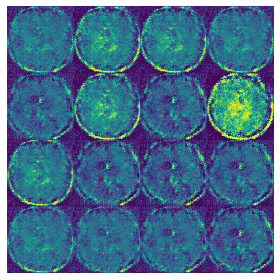

Disc: real loss: 0.382654 fake loss: 0.418452
GAN loss: 2.980259
Step 360 completed. Time took: 1 secs.
Begin step:  361
Disc: real loss: 0.401435 fake loss: 0.368635
GAN loss: 1.910857
Step 361 completed. Time took: 0 secs.
Begin step:  362
Disc: real loss: 0.405241 fake loss: 0.428184
GAN loss: 1.634740
Step 362 completed. Time took: 0 secs.
Begin step:  363
Disc: real loss: 0.358995 fake loss: 0.369755
GAN loss: 1.179677
Step 363 completed. Time took: 0 secs.
Begin step:  364
Disc: real loss: 0.316283 fake loss: 0.698454
GAN loss: 5.488402
Step 364 completed. Time took: 0 secs.
Begin step:  365
Disc: real loss: 2.384495 fake loss: 0.366888
GAN loss: 0.955274
Step 365 completed. Time took: 0 secs.
Begin step:  366
Disc: real loss: 0.477953 fake loss: 0.728976
GAN loss: 3.359513
Step 366 completed. Time took: 0 secs.
Begin step:  367
Disc: real loss: 0.643052 fake loss: 0.342425
GAN loss: 1.974666
Step 367 completed. Time took: 0 secs.
Begin step:  368
Disc: real loss: 0.392741 fake l

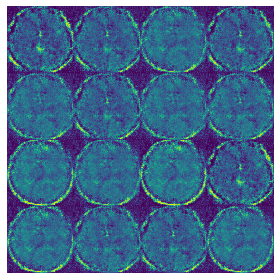

Disc: real loss: 0.368305 fake loss: 0.342522
GAN loss: 2.561351
Step 370 completed. Time took: 1 secs.
Begin step:  371
Disc: real loss: 0.526599 fake loss: 0.780942
GAN loss: 3.434725
Step 371 completed. Time took: 0 secs.
Begin step:  372
Disc: real loss: 0.700880 fake loss: 0.448903
GAN loss: 1.569283
Step 372 completed. Time took: 0 secs.
Begin step:  373
Disc: real loss: 0.471948 fake loss: 0.662551
GAN loss: 5.564218
Step 373 completed. Time took: 0 secs.
Begin step:  374
Disc: real loss: 0.983205 fake loss: 0.309599
GAN loss: 1.905458
Step 374 completed. Time took: 0 secs.
Begin step:  375
Disc: real loss: 0.378466 fake loss: 0.402263
GAN loss: 1.765711
Step 375 completed. Time took: 0 secs.
Begin step:  376
Disc: real loss: 0.326976 fake loss: 0.463937
GAN loss: 3.350808
Step 376 completed. Time took: 0 secs.
Begin step:  377
Disc: real loss: 0.590195 fake loss: 0.332630
GAN loss: 1.808650
Step 377 completed. Time took: 0 secs.
Begin step:  378
Disc: real loss: 0.360571 fake l

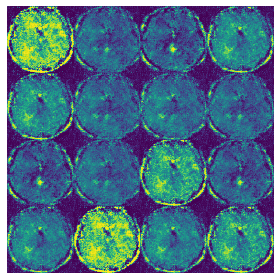

Disc: real loss: 0.309288 fake loss: 0.433201
GAN loss: 2.741348
Step 380 completed. Time took: 1 secs.
Begin step:  381
Disc: real loss: 0.449198 fake loss: 0.522329
GAN loss: 2.992693
Step 381 completed. Time took: 0 secs.
Begin step:  382
Disc: real loss: 0.448919 fake loss: 0.403865
GAN loss: 2.849636
Step 382 completed. Time took: 0 secs.
Begin step:  383
Disc: real loss: 0.513820 fake loss: 1.010327
GAN loss: 4.874579
Step 383 completed. Time took: 0 secs.
Begin step:  384
Disc: real loss: 1.078821 fake loss: 0.414315
GAN loss: 2.364253
Step 384 completed. Time took: 0 secs.
Begin step:  385
Disc: real loss: 0.471831 fake loss: 0.564281
GAN loss: 3.152386
Step 385 completed. Time took: 0 secs.
Begin step:  386
Disc: real loss: 0.439519 fake loss: 0.400123
GAN loss: 2.799659
Step 386 completed. Time took: 0 secs.
Begin step:  387
Disc: real loss: 0.566103 fake loss: 0.531081
GAN loss: 2.033240
Step 387 completed. Time took: 0 secs.
Begin step:  388
Disc: real loss: 0.412422 fake l

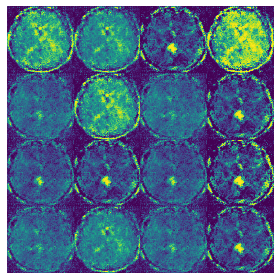

Disc: real loss: 0.378347 fake loss: 0.547503
GAN loss: 2.342050
Step 390 completed. Time took: 1 secs.
Begin step:  391
Disc: real loss: 0.455673 fake loss: 0.440807
GAN loss: 2.329980
Step 391 completed. Time took: 0 secs.
Begin step:  392
Disc: real loss: 0.412526 fake loss: 0.465756
GAN loss: 1.376280
Step 392 completed. Time took: 0 secs.
Begin step:  393
Disc: real loss: 0.528857 fake loss: 0.300172
GAN loss: 2.415847
Step 393 completed. Time took: 0 secs.
Begin step:  394
Disc: real loss: 0.374117 fake loss: 0.445600
GAN loss: 2.805142
Step 394 completed. Time took: 0 secs.
Begin step:  395
Disc: real loss: 0.581973 fake loss: 0.565365
GAN loss: 3.055154
Step 395 completed. Time took: 0 secs.
Begin step:  396
Disc: real loss: 0.415403 fake loss: 0.374003
GAN loss: 2.435181
Step 396 completed. Time took: 0 secs.
Begin step:  397
Disc: real loss: 0.371529 fake loss: 0.602568
GAN loss: 2.664789
Step 397 completed. Time took: 0 secs.
Begin step:  398
Disc: real loss: 0.474381 fake l

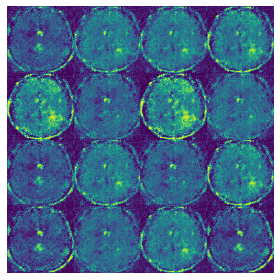

Disc: real loss: 0.434428 fake loss: 0.337974
GAN loss: 1.938140
Step 400 completed. Time took: 1 secs.
Begin step:  401
Disc: real loss: 0.429938 fake loss: 0.575966
GAN loss: 2.650589
Step 401 completed. Time took: 0 secs.
Begin step:  402
Disc: real loss: 0.349163 fake loss: 0.283411
GAN loss: 2.680819
Step 402 completed. Time took: 0 secs.
Begin step:  403
Disc: real loss: 0.571159 fake loss: 1.234068
GAN loss: 7.211974
Step 403 completed. Time took: 0 secs.
Begin step:  404
Disc: real loss: 1.476295 fake loss: 0.405562
GAN loss: 2.608505
Step 404 completed. Time took: 0 secs.
Begin step:  405
Disc: real loss: 0.434749 fake loss: 0.425952
GAN loss: 2.645958
Step 405 completed. Time took: 0 secs.
Begin step:  406
Disc: real loss: 0.425127 fake loss: 0.355196
GAN loss: 2.552614
Step 406 completed. Time took: 0 secs.
Begin step:  407
Disc: real loss: 0.390865 fake loss: 0.405383
GAN loss: 1.802832
Step 407 completed. Time took: 0 secs.
Begin step:  408
Disc: real loss: 0.392956 fake l

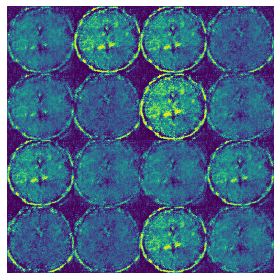

Disc: real loss: 0.605988 fake loss: 0.322957
GAN loss: 1.828571
Step 410 completed. Time took: 1 secs.
Begin step:  411
Disc: real loss: 0.342128 fake loss: 0.440651
GAN loss: 3.007590
Step 411 completed. Time took: 0 secs.
Begin step:  412
Disc: real loss: 0.621610 fake loss: 0.611037
GAN loss: 2.192801
Step 412 completed. Time took: 0 secs.
Begin step:  413
Disc: real loss: 0.441186 fake loss: 0.388063
GAN loss: 3.145188
Step 413 completed. Time took: 0 secs.
Begin step:  414
Disc: real loss: 0.735234 fake loss: 0.568033
GAN loss: 2.500200
Step 414 completed. Time took: 0 secs.
Begin step:  415
Disc: real loss: 0.459653 fake loss: 0.337329
GAN loss: 2.396257
Step 415 completed. Time took: 0 secs.
Begin step:  416
Disc: real loss: 0.371869 fake loss: 0.356537
GAN loss: 3.000044
Step 416 completed. Time took: 0 secs.
Begin step:  417
Disc: real loss: 0.600374 fake loss: 0.434074
GAN loss: 2.202480
Step 417 completed. Time took: 0 secs.
Begin step:  418
Disc: real loss: 0.403201 fake l

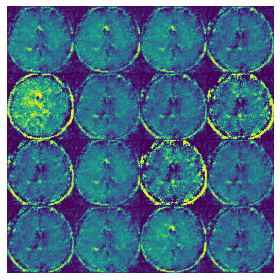

Disc: real loss: 0.351599 fake loss: 0.338390
GAN loss: 1.501776
Step 420 completed. Time took: 1 secs.
Begin step:  421
Disc: real loss: 0.349105 fake loss: 0.381325
GAN loss: 0.618840
Step 421 completed. Time took: 0 secs.
Begin step:  422
Disc: real loss: 0.411531 fake loss: 1.707646
GAN loss: 9.722702
Step 422 completed. Time took: 0 secs.
Begin step:  423
Disc: real loss: 4.571223 fake loss: 0.548308
GAN loss: 5.159541
Step 423 completed. Time took: 0 secs.
Begin step:  424
Disc: real loss: 0.710590 fake loss: 0.554468
GAN loss: 1.862941
Step 424 completed. Time took: 0 secs.
Begin step:  425
Disc: real loss: 0.384342 fake loss: 0.488253
GAN loss: 1.766404
Step 425 completed. Time took: 0 secs.
Begin step:  426
Disc: real loss: 0.337492 fake loss: 0.377757
GAN loss: 2.066335
Step 426 completed. Time took: 0 secs.
Begin step:  427
Disc: real loss: 0.496431 fake loss: 0.481520
GAN loss: 1.631774
Step 427 completed. Time took: 0 secs.
Begin step:  428
Disc: real loss: 0.539912 fake l

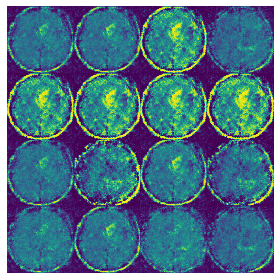

Disc: real loss: 0.392627 fake loss: 0.278720
GAN loss: 2.814138
Step 430 completed. Time took: 1 secs.
Begin step:  431
Disc: real loss: 0.496852 fake loss: 0.649101
GAN loss: 3.290625
Step 431 completed. Time took: 0 secs.
Begin step:  432
Disc: real loss: 0.515957 fake loss: 0.382639
GAN loss: 1.985480
Step 432 completed. Time took: 0 secs.
Begin step:  433
Disc: real loss: 0.374516 fake loss: 0.394762
GAN loss: 2.269671
Step 433 completed. Time took: 0 secs.
Begin step:  434
Disc: real loss: 0.413223 fake loss: 0.369900
GAN loss: 2.391151
Step 434 completed. Time took: 0 secs.
Begin step:  435
Disc: real loss: 0.412867 fake loss: 0.387445
GAN loss: 2.262698
Step 435 completed. Time took: 0 secs.
Begin step:  436
Disc: real loss: 0.417888 fake loss: 0.347527
GAN loss: 1.938303
Step 436 completed. Time took: 0 secs.
Begin step:  437
Disc: real loss: 0.305636 fake loss: 0.368985
GAN loss: 2.397407
Step 437 completed. Time took: 0 secs.
Begin step:  438
Disc: real loss: 0.400820 fake l

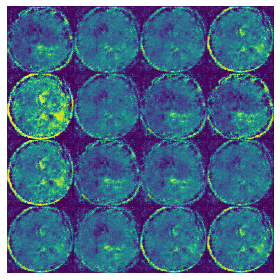

Disc: real loss: 0.387795 fake loss: 0.404998
GAN loss: 2.400917
Step 440 completed. Time took: 1 secs.
Begin step:  441
Disc: real loss: 0.401740 fake loss: 0.543339
GAN loss: 2.781497
Step 441 completed. Time took: 0 secs.
Begin step:  442
Disc: real loss: 0.394299 fake loss: 0.372112
GAN loss: 3.073503
Step 442 completed. Time took: 0 secs.
Begin step:  443
Disc: real loss: 0.458525 fake loss: 0.663953
GAN loss: 3.450120
Step 443 completed. Time took: 0 secs.
Begin step:  444
Disc: real loss: 0.441662 fake loss: 0.402081
GAN loss: 2.908989
Step 444 completed. Time took: 0 secs.
Begin step:  445
Disc: real loss: 0.438342 fake loss: 0.409080
GAN loss: 1.996974
Step 445 completed. Time took: 0 secs.
Begin step:  446
Disc: real loss: 0.413218 fake loss: 0.314731
GAN loss: 1.790991
Step 446 completed. Time took: 0 secs.
Begin step:  447
Disc: real loss: 0.496476 fake loss: 0.570140
GAN loss: 1.370952
Step 447 completed. Time took: 0 secs.
Begin step:  448
Disc: real loss: 0.493990 fake l

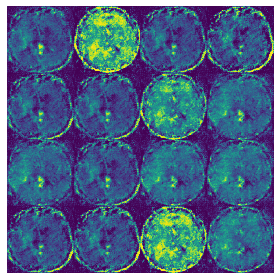

Disc: real loss: 0.762227 fake loss: 0.315455
GAN loss: 2.810830
Step 450 completed. Time took: 1 secs.
Begin step:  451
Disc: real loss: 0.428067 fake loss: 0.473789
GAN loss: 2.737782
Step 451 completed. Time took: 0 secs.
Begin step:  452
Disc: real loss: 0.385683 fake loss: 0.347875
GAN loss: 1.985316
Step 452 completed. Time took: 0 secs.
Begin step:  453
Disc: real loss: 0.429252 fake loss: 0.365899
GAN loss: 2.060199
Step 453 completed. Time took: 0 secs.
Begin step:  454
Disc: real loss: 0.406300 fake loss: 0.418675
GAN loss: 1.549657
Step 454 completed. Time took: 0 secs.
Begin step:  455
Disc: real loss: 0.363137 fake loss: 0.354960
GAN loss: 2.091578
Step 455 completed. Time took: 0 secs.
Begin step:  456
Disc: real loss: 0.545406 fake loss: 0.733919
GAN loss: 3.259653
Step 456 completed. Time took: 0 secs.
Begin step:  457
Disc: real loss: 0.502353 fake loss: 0.323637
GAN loss: 2.687965
Step 457 completed. Time took: 0 secs.
Begin step:  458
Disc: real loss: 0.353078 fake l

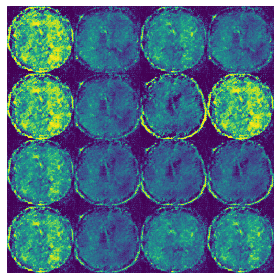

Disc: real loss: 0.344813 fake loss: 0.359884
GAN loss: 2.331161
Step 460 completed. Time took: 1 secs.
Begin step:  461
Disc: real loss: 0.327978 fake loss: 0.355367
GAN loss: 2.225499
Step 461 completed. Time took: 0 secs.
Begin step:  462
Disc: real loss: 0.437426 fake loss: 0.580985
GAN loss: 3.196487
Step 462 completed. Time took: 0 secs.
Begin step:  463
Disc: real loss: 0.901846 fake loss: 0.664414
GAN loss: 3.243853
Step 463 completed. Time took: 0 secs.
Begin step:  464
Disc: real loss: 0.403369 fake loss: 0.426839
GAN loss: 2.629098
Step 464 completed. Time took: 0 secs.
Begin step:  465
Disc: real loss: 0.334669 fake loss: 0.398667
GAN loss: 2.035892
Step 465 completed. Time took: 0 secs.
Begin step:  466
Disc: real loss: 0.337802 fake loss: 0.324955
GAN loss: 2.382790
Step 466 completed. Time took: 0 secs.
Begin step:  467
Disc: real loss: 0.462057 fake loss: 0.426949
GAN loss: 2.148717
Step 467 completed. Time took: 0 secs.
Begin step:  468
Disc: real loss: 0.397599 fake l

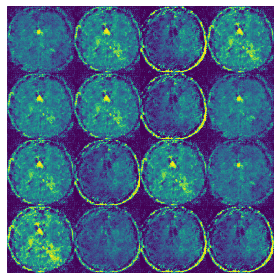

Disc: real loss: 0.582805 fake loss: 0.531285
GAN loss: 3.762816
Step 470 completed. Time took: 1 secs.
Begin step:  471
Disc: real loss: 0.369842 fake loss: 0.387941
GAN loss: 2.050855
Step 471 completed. Time took: 0 secs.
Begin step:  472
Disc: real loss: 0.488792 fake loss: 0.305775
GAN loss: 1.227779
Step 472 completed. Time took: 0 secs.
Begin step:  473
Disc: real loss: 0.602946 fake loss: 1.935471
GAN loss: 7.190610
Step 473 completed. Time took: 0 secs.
Begin step:  474
Disc: real loss: 2.546584 fake loss: 0.534058
GAN loss: 2.389030
Step 474 completed. Time took: 0 secs.
Begin step:  475
Disc: real loss: 0.526453 fake loss: 0.456310
GAN loss: 2.921967
Step 475 completed. Time took: 0 secs.
Begin step:  476
Disc: real loss: 0.306854 fake loss: 0.423518
GAN loss: 3.000781
Step 476 completed. Time took: 0 secs.
Begin step:  477
Disc: real loss: 0.847947 fake loss: 1.163972
GAN loss: 3.182874
Step 477 completed. Time took: 0 secs.
Begin step:  478
Disc: real loss: 0.387311 fake l

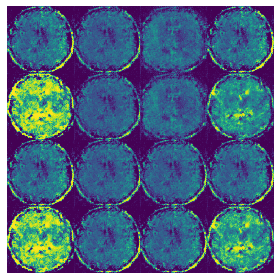

Disc: real loss: 0.403713 fake loss: 0.538017
GAN loss: 3.048579
Step 480 completed. Time took: 1 secs.
Begin step:  481
Disc: real loss: 0.615102 fake loss: 0.296391
GAN loss: 2.392133
Step 481 completed. Time took: 0 secs.
Begin step:  482
Disc: real loss: 0.433974 fake loss: 0.567669
GAN loss: 1.614975
Step 482 completed. Time took: 0 secs.
Begin step:  483
Disc: real loss: 0.383548 fake loss: 0.427622
GAN loss: 2.498213
Step 483 completed. Time took: 0 secs.
Begin step:  484
Disc: real loss: 0.348685 fake loss: 0.367566
GAN loss: 1.808016
Step 484 completed. Time took: 0 secs.
Begin step:  485
Disc: real loss: 0.282755 fake loss: 0.392133
GAN loss: 2.061152
Step 485 completed. Time took: 0 secs.
Begin step:  486
Disc: real loss: 0.317309 fake loss: 0.496604
GAN loss: 3.226814
Step 486 completed. Time took: 0 secs.
Begin step:  487
Disc: real loss: 0.733017 fake loss: 0.469082
GAN loss: 1.685484
Step 487 completed. Time took: 0 secs.
Begin step:  488
Disc: real loss: 0.315764 fake l

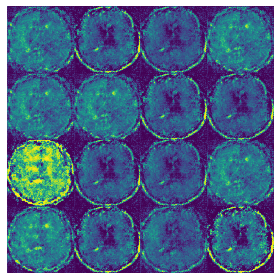

Disc: real loss: 0.479771 fake loss: 0.622840
GAN loss: 1.479419
Step 490 completed. Time took: 1 secs.
Begin step:  491
Disc: real loss: 0.324578 fake loss: 0.416941
GAN loss: 2.654677
Step 491 completed. Time took: 0 secs.
Begin step:  492
Disc: real loss: 0.513802 fake loss: 0.347507
GAN loss: 1.772260
Step 492 completed. Time took: 0 secs.
Begin step:  493
Disc: real loss: 0.409004 fake loss: 0.389596
GAN loss: 1.117265
Step 493 completed. Time took: 0 secs.
Begin step:  494
Disc: real loss: 0.342835 fake loss: 0.360583
GAN loss: 1.668605
Step 494 completed. Time took: 0 secs.
Begin step:  495
Disc: real loss: 0.419006 fake loss: 0.700389
GAN loss: 4.479400
Step 495 completed. Time took: 0 secs.
Begin step:  496
Disc: real loss: 0.902049 fake loss: 0.440312
GAN loss: 2.096330
Step 496 completed. Time took: 0 secs.
Begin step:  497
Disc: real loss: 0.399961 fake loss: 0.465689
GAN loss: 3.294570
Step 497 completed. Time took: 0 secs.
Begin step:  498
Disc: real loss: 0.376534 fake l

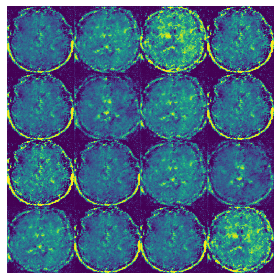

Disc: real loss: 0.549676 fake loss: 0.527210
GAN loss: 2.043739
Step 500 completed. Time took: 1 secs.
Begin step:  501
Disc: real loss: 0.360843 fake loss: 0.412926
GAN loss: 1.577809
Step 501 completed. Time took: 0 secs.
Begin step:  502
Disc: real loss: 0.358813 fake loss: 0.787163
GAN loss: 5.218282
Step 502 completed. Time took: 0 secs.
Begin step:  503
Disc: real loss: 1.085699 fake loss: 0.324815
GAN loss: 1.471333
Step 503 completed. Time took: 0 secs.
Begin step:  504
Disc: real loss: 0.315714 fake loss: 0.865725
GAN loss: 7.998211
Step 504 completed. Time took: 0 secs.
Begin step:  505
Disc: real loss: 1.106137 fake loss: 0.488262
GAN loss: 3.608068
Step 505 completed. Time took: 0 secs.
Begin step:  506
Disc: real loss: 0.431818 fake loss: 0.614104
GAN loss: 5.889503
Step 506 completed. Time took: 0 secs.
Begin step:  507
Disc: real loss: 0.566997 fake loss: 0.479842
GAN loss: 3.509045
Step 507 completed. Time took: 0 secs.
Begin step:  508
Disc: real loss: 0.401980 fake l

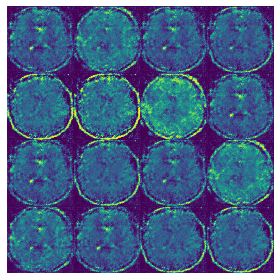

Disc: real loss: 0.921378 fake loss: 0.472485
GAN loss: 2.249314
Step 510 completed. Time took: 1 secs.
Begin step:  511
Disc: real loss: 0.427955 fake loss: 0.627154
GAN loss: 3.396597
Step 511 completed. Time took: 0 secs.
Begin step:  512
Disc: real loss: 0.444837 fake loss: 0.377969
GAN loss: 2.865225
Step 512 completed. Time took: 0 secs.
Begin step:  513
Disc: real loss: 0.324263 fake loss: 0.474092
GAN loss: 2.518477
Step 513 completed. Time took: 0 secs.
Begin step:  514
Disc: real loss: 0.323291 fake loss: 0.383617
GAN loss: 2.076266
Step 514 completed. Time took: 0 secs.
Begin step:  515
Disc: real loss: 0.394388 fake loss: 0.619395
GAN loss: 3.596838
Step 515 completed. Time took: 0 secs.
Begin step:  516
Disc: real loss: 0.448091 fake loss: 0.355130
GAN loss: 3.342983
Step 516 completed. Time took: 0 secs.
Begin step:  517
Disc: real loss: 0.708826 fake loss: 0.837317
GAN loss: 2.997955
Step 517 completed. Time took: 0 secs.
Begin step:  518
Disc: real loss: 0.339412 fake l

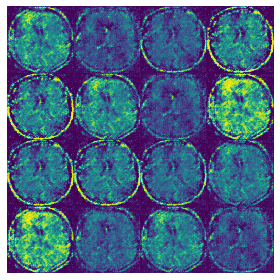

Disc: real loss: 0.369774 fake loss: 0.350992
GAN loss: 2.125108
Step 520 completed. Time took: 1 secs.
Begin step:  521
Disc: real loss: 0.482380 fake loss: 0.551761
GAN loss: 2.413994
Step 521 completed. Time took: 0 secs.
Begin step:  522
Disc: real loss: 0.402090 fake loss: 0.393291
GAN loss: 2.012365
Step 522 completed. Time took: 0 secs.
Begin step:  523
Disc: real loss: 0.376257 fake loss: 0.394182
GAN loss: 2.547662
Step 523 completed. Time took: 0 secs.
Begin step:  524
Disc: real loss: 0.394843 fake loss: 0.311956
GAN loss: 2.354288
Step 524 completed. Time took: 0 secs.
Begin step:  525
Disc: real loss: 0.367178 fake loss: 0.321659
GAN loss: 2.395287
Step 525 completed. Time took: 0 secs.
Begin step:  526
Disc: real loss: 0.456438 fake loss: 0.659945
GAN loss: 3.444323
Step 526 completed. Time took: 0 secs.
Begin step:  527
Disc: real loss: 0.629403 fake loss: 0.396847
GAN loss: 1.718602
Step 527 completed. Time took: 0 secs.
Begin step:  528
Disc: real loss: 0.414907 fake l

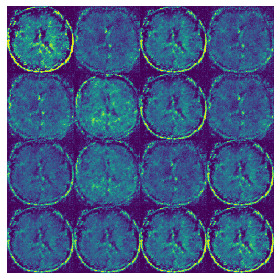

Disc: real loss: 0.457764 fake loss: 0.522661
GAN loss: 3.282396
Step 530 completed. Time took: 1 secs.
Begin step:  531
Disc: real loss: 0.509603 fake loss: 0.310217
GAN loss: 2.311803
Step 531 completed. Time took: 0 secs.
Begin step:  532
Disc: real loss: 0.344282 fake loss: 0.339817
GAN loss: 2.108420
Step 532 completed. Time took: 0 secs.
Begin step:  533
Disc: real loss: 0.384464 fake loss: 0.447696
GAN loss: 2.934838
Step 533 completed. Time took: 0 secs.
Begin step:  534
Disc: real loss: 0.358699 fake loss: 0.326519
GAN loss: 2.677106
Step 534 completed. Time took: 0 secs.
Begin step:  535
Disc: real loss: 0.607749 fake loss: 0.586340
GAN loss: 2.453162
Step 535 completed. Time took: 0 secs.
Begin step:  536
Disc: real loss: 0.364586 fake loss: 0.366014
GAN loss: 2.855124
Step 536 completed. Time took: 0 secs.
Begin step:  537
Disc: real loss: 0.509494 fake loss: 0.592129
GAN loss: 2.834585
Step 537 completed. Time took: 0 secs.
Begin step:  538
Disc: real loss: 0.316627 fake l

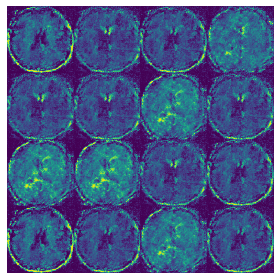

Disc: real loss: 0.481268 fake loss: 0.378656
GAN loss: 1.895277
Step 540 completed. Time took: 1 secs.
Begin step:  541
Disc: real loss: 0.342294 fake loss: 0.466971
GAN loss: 2.864218
Step 541 completed. Time took: 0 secs.
Begin step:  542
Disc: real loss: 0.448669 fake loss: 0.342636
GAN loss: 1.793329
Step 542 completed. Time took: 0 secs.
Begin step:  543
Disc: real loss: 0.367921 fake loss: 0.963475
GAN loss: 6.679030
Step 543 completed. Time took: 0 secs.
Begin step:  544
Disc: real loss: 1.157118 fake loss: 0.408871
GAN loss: 2.082728
Step 544 completed. Time took: 0 secs.
Begin step:  545
Disc: real loss: 0.540955 fake loss: 0.606345
GAN loss: 3.976990
Step 545 completed. Time took: 0 secs.
Begin step:  546
Disc: real loss: 0.441769 fake loss: 0.628492
GAN loss: 4.117580
Step 546 completed. Time took: 0 secs.
Begin step:  547
Disc: real loss: 0.409994 fake loss: 0.435053
GAN loss: 2.009206
Step 547 completed. Time took: 0 secs.
Begin step:  548
Disc: real loss: 0.448762 fake l

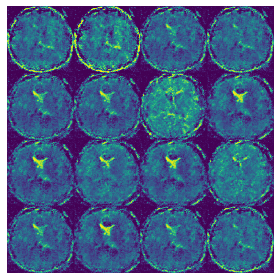

Disc: real loss: 0.561741 fake loss: 0.351085
GAN loss: 2.409604
Step 550 completed. Time took: 1 secs.
Begin step:  551
Disc: real loss: 0.329813 fake loss: 0.718543
GAN loss: 3.742014
Step 551 completed. Time took: 0 secs.
Begin step:  552
Disc: real loss: 0.554852 fake loss: 0.348405
GAN loss: 3.095999
Step 552 completed. Time took: 0 secs.
Begin step:  553
Disc: real loss: 0.355327 fake loss: 0.377561
GAN loss: 2.023734
Step 553 completed. Time took: 0 secs.
Begin step:  554
Disc: real loss: 0.329401 fake loss: 0.438441
GAN loss: 2.508785
Step 554 completed. Time took: 0 secs.
Begin step:  555
Disc: real loss: 0.605803 fake loss: 0.801296
GAN loss: 6.784602
Step 555 completed. Time took: 0 secs.
Begin step:  556
Disc: real loss: 0.644784 fake loss: 0.669431
GAN loss: 2.921750
Step 556 completed. Time took: 0 secs.
Begin step:  557
Disc: real loss: 0.443985 fake loss: 0.504760
GAN loss: 2.623442
Step 557 completed. Time took: 0 secs.
Begin step:  558
Disc: real loss: 0.357967 fake l

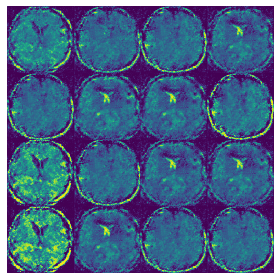

Disc: real loss: 0.440085 fake loss: 0.412302
GAN loss: 2.032954
Step 560 completed. Time took: 1 secs.
Begin step:  561
Disc: real loss: 0.413271 fake loss: 0.511841
GAN loss: 2.761831
Step 561 completed. Time took: 0 secs.
Begin step:  562
Disc: real loss: 0.409034 fake loss: 0.331377
GAN loss: 1.966681
Step 562 completed. Time took: 0 secs.
Begin step:  563
Disc: real loss: 0.312789 fake loss: 0.471206
GAN loss: 3.146082
Step 563 completed. Time took: 0 secs.
Begin step:  564
Disc: real loss: 0.481186 fake loss: 0.298496
GAN loss: 1.863796
Step 564 completed. Time took: 0 secs.
Begin step:  565
Disc: real loss: 0.315906 fake loss: 0.442653
GAN loss: 2.487549
Step 565 completed. Time took: 0 secs.
Begin step:  566
Disc: real loss: 0.333482 fake loss: 0.294790
GAN loss: 2.104806
Step 566 completed. Time took: 0 secs.
Begin step:  567
Disc: real loss: 0.388415 fake loss: 0.413651
GAN loss: 2.384839
Step 567 completed. Time took: 0 secs.
Begin step:  568
Disc: real loss: 0.369922 fake l

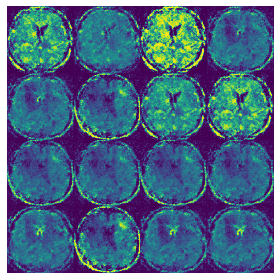

Disc: real loss: 0.647962 fake loss: 0.377420
GAN loss: 1.342313
Step 570 completed. Time took: 1 secs.
Begin step:  571
Disc: real loss: 0.422427 fake loss: 0.580296
GAN loss: 4.295456
Step 571 completed. Time took: 0 secs.
Begin step:  572
Disc: real loss: 0.978994 fake loss: 0.369850
GAN loss: 1.863540
Step 572 completed. Time took: 0 secs.
Begin step:  573
Disc: real loss: 0.396160 fake loss: 0.422941
GAN loss: 2.424629
Step 573 completed. Time took: 0 secs.
Begin step:  574
Disc: real loss: 0.333021 fake loss: 0.371729
GAN loss: 2.672879
Step 574 completed. Time took: 0 secs.
Begin step:  575
Disc: real loss: 0.377702 fake loss: 0.371289
GAN loss: 1.433220
Step 575 completed. Time took: 0 secs.
Begin step:  576
Disc: real loss: 0.366056 fake loss: 0.549773
GAN loss: 4.041997
Step 576 completed. Time took: 0 secs.
Begin step:  577
Disc: real loss: 0.605298 fake loss: 0.355522
GAN loss: 2.854718
Step 577 completed. Time took: 0 secs.
Begin step:  578
Disc: real loss: 0.470262 fake l

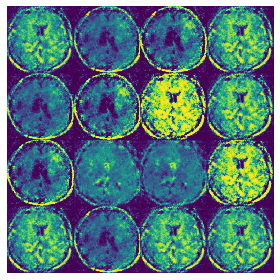

Disc: real loss: 0.385633 fake loss: 0.433647
GAN loss: 1.103397
Step 580 completed. Time took: 1 secs.
Begin step:  581
Disc: real loss: 0.374468 fake loss: 1.052024
GAN loss: 4.360230
Step 581 completed. Time took: 0 secs.
Begin step:  582
Disc: real loss: 1.184168 fake loss: 0.348875
GAN loss: 2.146952
Step 582 completed. Time took: 0 secs.
Begin step:  583
Disc: real loss: 0.356182 fake loss: 0.615492
GAN loss: 2.974178
Step 583 completed. Time took: 0 secs.
Begin step:  584
Disc: real loss: 0.443015 fake loss: 0.389502
GAN loss: 2.648982
Step 584 completed. Time took: 0 secs.
Begin step:  585
Disc: real loss: 0.415164 fake loss: 0.444395
GAN loss: 2.672264
Step 585 completed. Time took: 0 secs.
Begin step:  586
Disc: real loss: 0.588029 fake loss: 0.436149
GAN loss: 2.419148
Step 586 completed. Time took: 0 secs.
Begin step:  587
Disc: real loss: 0.390978 fake loss: 0.385262
GAN loss: 2.511637
Step 587 completed. Time took: 0 secs.
Begin step:  588
Disc: real loss: 0.366490 fake l

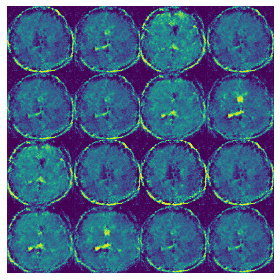

Disc: real loss: 0.389583 fake loss: 0.474323
GAN loss: 3.983021
Step 590 completed. Time took: 1 secs.
Begin step:  591
Disc: real loss: 0.410200 fake loss: 0.308050
GAN loss: 2.722933
Step 591 completed. Time took: 0 secs.
Begin step:  592
Disc: real loss: 0.393111 fake loss: 0.539887
GAN loss: 4.227359
Step 592 completed. Time took: 0 secs.
Begin step:  593
Disc: real loss: 0.556325 fake loss: 0.490903
GAN loss: 3.461048
Step 593 completed. Time took: 0 secs.
Begin step:  594
Disc: real loss: 0.374213 fake loss: 0.414807
GAN loss: 2.884240
Step 594 completed. Time took: 0 secs.
Begin step:  595
Disc: real loss: 0.257380 fake loss: 0.409069
GAN loss: 2.920615
Step 595 completed. Time took: 0 secs.
Begin step:  596
Disc: real loss: 0.362698 fake loss: 0.404893
GAN loss: 2.165631
Step 596 completed. Time took: 0 secs.
Begin step:  597
Disc: real loss: 0.457469 fake loss: 0.742363
GAN loss: 6.569542
Step 597 completed. Time took: 0 secs.
Begin step:  598
Disc: real loss: 0.901613 fake l

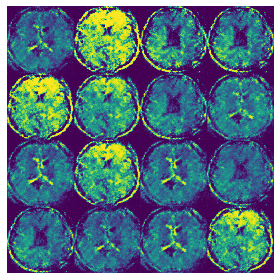

Disc: real loss: 0.391864 fake loss: 0.398316
GAN loss: 1.649681
Step 600 completed. Time took: 1 secs.
Begin step:  601
Disc: real loss: 0.304159 fake loss: 0.452590
GAN loss: 2.465690
Step 601 completed. Time took: 0 secs.
Begin step:  602
Disc: real loss: 0.297792 fake loss: 0.359121
GAN loss: 2.611427
Step 602 completed. Time took: 0 secs.
Begin step:  603
Disc: real loss: 0.530317 fake loss: 0.535422
GAN loss: 1.587783
Step 603 completed. Time took: 0 secs.
Begin step:  604
Disc: real loss: 0.352999 fake loss: 0.343904
GAN loss: 1.798113
Step 604 completed. Time took: 0 secs.
Begin step:  605
Disc: real loss: 0.422885 fake loss: 0.460672
GAN loss: 3.669875
Step 605 completed. Time took: 0 secs.
Begin step:  606
Disc: real loss: 1.006815 fake loss: 0.302987
GAN loss: 1.811642
Step 606 completed. Time took: 0 secs.
Begin step:  607
Disc: real loss: 0.431094 fake loss: 0.432354
GAN loss: 3.641853
Step 607 completed. Time took: 0 secs.
Begin step:  608
Disc: real loss: 0.465204 fake l

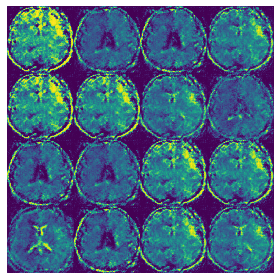

Disc: real loss: 0.391851 fake loss: 0.385011
GAN loss: 3.603658
Step 610 completed. Time took: 1 secs.
Begin step:  611
Disc: real loss: 0.477659 fake loss: 0.451550
GAN loss: 3.175701
Step 611 completed. Time took: 0 secs.
Begin step:  612
Disc: real loss: 0.804071 fake loss: 0.641029
GAN loss: 2.813418
Step 612 completed. Time took: 0 secs.
Begin step:  613
Disc: real loss: 0.361191 fake loss: 0.469856
GAN loss: 3.256635
Step 613 completed. Time took: 0 secs.
Begin step:  614
Disc: real loss: 0.354580 fake loss: 0.373066
GAN loss: 1.994148
Step 614 completed. Time took: 0 secs.
Begin step:  615
Disc: real loss: 0.355250 fake loss: 0.461131
GAN loss: 2.348072
Step 615 completed. Time took: 0 secs.
Begin step:  616
Disc: real loss: 0.393034 fake loss: 0.321738
GAN loss: 2.225236
Step 616 completed. Time took: 0 secs.
Begin step:  617
Disc: real loss: 0.333378 fake loss: 0.348553
GAN loss: 1.995018
Step 617 completed. Time took: 0 secs.
Begin step:  618
Disc: real loss: 0.373044 fake l

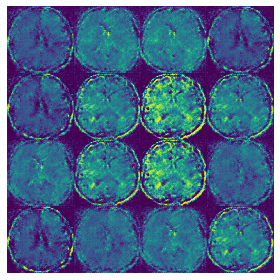

Disc: real loss: 0.411338 fake loss: 0.386569
GAN loss: 2.535209
Step 620 completed. Time took: 1 secs.
Begin step:  621
Disc: real loss: 0.334535 fake loss: 0.320789
GAN loss: 1.913804
Step 621 completed. Time took: 0 secs.
Begin step:  622
Disc: real loss: 0.383052 fake loss: 0.424855
GAN loss: 2.494445
Step 622 completed. Time took: 0 secs.
Begin step:  623
Disc: real loss: 0.338158 fake loss: 0.413861
GAN loss: 2.450524
Step 623 completed. Time took: 0 secs.
Begin step:  624
Disc: real loss: 0.355332 fake loss: 0.369159
GAN loss: 2.169148
Step 624 completed. Time took: 0 secs.
Begin step:  625
Disc: real loss: 0.356780 fake loss: 0.315865
GAN loss: 2.406311
Step 625 completed. Time took: 0 secs.
Begin step:  626
Disc: real loss: 0.439622 fake loss: 0.355875
GAN loss: 1.946546
Step 626 completed. Time took: 0 secs.
Begin step:  627
Disc: real loss: 0.306065 fake loss: 0.309475
GAN loss: 2.009900
Step 627 completed. Time took: 0 secs.
Begin step:  628
Disc: real loss: 0.356671 fake l

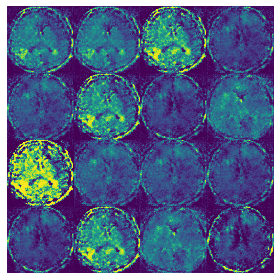

Disc: real loss: 0.405453 fake loss: 0.310001
GAN loss: 2.667669
Step 630 completed. Time took: 1 secs.
Begin step:  631
Disc: real loss: 0.422606 fake loss: 0.564516
GAN loss: 4.107619
Step 631 completed. Time took: 0 secs.
Begin step:  632
Disc: real loss: 0.345420 fake loss: 0.617456
GAN loss: 3.858207
Step 632 completed. Time took: 0 secs.
Begin step:  633
Disc: real loss: 0.340151 fake loss: 0.473602
GAN loss: 2.096701
Step 633 completed. Time took: 0 secs.
Begin step:  634
Disc: real loss: 0.322412 fake loss: 0.303697
GAN loss: 1.945211
Step 634 completed. Time took: 0 secs.
Begin step:  635
Disc: real loss: 0.361094 fake loss: 0.369991
GAN loss: 1.408655
Step 635 completed. Time took: 0 secs.
Begin step:  636
Disc: real loss: 0.424438 fake loss: 0.419377
GAN loss: 2.769097
Step 636 completed. Time took: 0 secs.
Begin step:  637
Disc: real loss: 0.594005 fake loss: 0.544481
GAN loss: 2.774606
Step 637 completed. Time took: 0 secs.
Begin step:  638
Disc: real loss: 0.396758 fake l

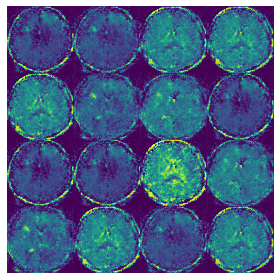

Disc: real loss: 0.360113 fake loss: 0.388086
GAN loss: 2.767087
Step 640 completed. Time took: 1 secs.
Begin step:  641
Disc: real loss: 0.507697 fake loss: 0.521087
GAN loss: 3.477365
Step 641 completed. Time took: 0 secs.
Begin step:  642
Disc: real loss: 0.397233 fake loss: 0.366365
GAN loss: 2.979788
Step 642 completed. Time took: 0 secs.
Begin step:  643
Disc: real loss: 0.360754 fake loss: 0.351366
GAN loss: 1.868202
Step 643 completed. Time took: 0 secs.
Begin step:  644
Disc: real loss: 0.410223 fake loss: 0.341733
GAN loss: 2.585856
Step 644 completed. Time took: 0 secs.
Begin step:  645
Disc: real loss: 0.428721 fake loss: 0.337048
GAN loss: 0.940988
Step 645 completed. Time took: 0 secs.
Begin step:  646
Disc: real loss: 0.309230 fake loss: 0.918307
GAN loss: 6.657650
Step 646 completed. Time took: 0 secs.
Begin step:  647
Disc: real loss: 2.122749 fake loss: 0.588466
GAN loss: 2.163792
Step 647 completed. Time took: 0 secs.
Begin step:  648
Disc: real loss: 0.328453 fake l

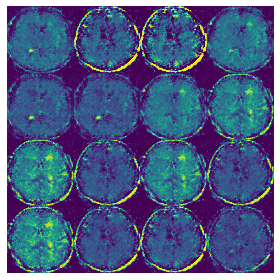

Disc: real loss: 0.405000 fake loss: 0.323707
GAN loss: 2.178417
Step 650 completed. Time took: 1 secs.
Begin step:  651
Disc: real loss: 0.372978 fake loss: 0.435565
GAN loss: 2.897637
Step 651 completed. Time took: 0 secs.
Begin step:  652
Disc: real loss: 0.620898 fake loss: 0.567088
GAN loss: 3.401523
Step 652 completed. Time took: 0 secs.
Begin step:  653
Disc: real loss: 0.395160 fake loss: 0.483539
GAN loss: 3.823663
Step 653 completed. Time took: 0 secs.
Begin step:  654
Disc: real loss: 0.447165 fake loss: 0.369031
GAN loss: 2.146623
Step 654 completed. Time took: 0 secs.
Begin step:  655
Disc: real loss: 0.469158 fake loss: 0.657333
GAN loss: 3.288558
Step 655 completed. Time took: 0 secs.
Begin step:  656
Disc: real loss: 0.398795 fake loss: 0.372455
GAN loss: 3.012747
Step 656 completed. Time took: 0 secs.
Begin step:  657
Disc: real loss: 0.336897 fake loss: 0.442677
GAN loss: 2.639652
Step 657 completed. Time took: 0 secs.
Begin step:  658
Disc: real loss: 0.373187 fake l

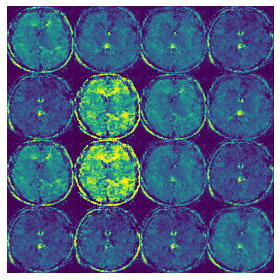

Disc: real loss: 0.375961 fake loss: 0.443754
GAN loss: 2.532478
Step 660 completed. Time took: 1 secs.
Begin step:  661
Disc: real loss: 0.349556 fake loss: 0.317261
GAN loss: 2.330897
Step 661 completed. Time took: 0 secs.
Begin step:  662
Disc: real loss: 0.417774 fake loss: 0.644364
GAN loss: 4.003020
Step 662 completed. Time took: 0 secs.
Begin step:  663
Disc: real loss: 0.821467 fake loss: 0.311060
GAN loss: 1.943457
Step 663 completed. Time took: 0 secs.
Begin step:  664
Disc: real loss: 0.505904 fake loss: 0.373210
GAN loss: 2.064369
Step 664 completed. Time took: 0 secs.
Begin step:  665
Disc: real loss: 0.347517 fake loss: 0.308792
GAN loss: 2.659416
Step 665 completed. Time took: 0 secs.
Begin step:  666
Disc: real loss: 0.440401 fake loss: 0.488583
GAN loss: 2.907960
Step 666 completed. Time took: 0 secs.
Begin step:  667
Disc: real loss: 0.393805 fake loss: 0.294596
GAN loss: 2.664214
Step 667 completed. Time took: 0 secs.
Begin step:  668
Disc: real loss: 0.395710 fake l

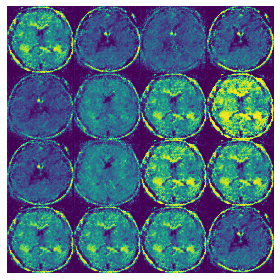

Disc: real loss: 0.472774 fake loss: 0.394666
GAN loss: 2.713151
Step 670 completed. Time took: 1 secs.
Begin step:  671
Disc: real loss: 0.417913 fake loss: 0.350524
GAN loss: 2.861777
Step 671 completed. Time took: 0 secs.
Begin step:  672
Disc: real loss: 0.354820 fake loss: 0.340610
GAN loss: 1.890915
Step 672 completed. Time took: 0 secs.
Begin step:  673
Disc: real loss: 0.386956 fake loss: 0.378201
GAN loss: 2.119506
Step 673 completed. Time took: 0 secs.
Begin step:  674
Disc: real loss: 0.312637 fake loss: 0.421952
GAN loss: 2.844225
Step 674 completed. Time took: 0 secs.
Begin step:  675
Disc: real loss: 0.458697 fake loss: 0.288049
GAN loss: 2.209559
Step 675 completed. Time took: 0 secs.
Begin step:  676
Disc: real loss: 0.324025 fake loss: 0.346055
GAN loss: 2.005507
Step 676 completed. Time took: 0 secs.
Begin step:  677
Disc: real loss: 0.384099 fake loss: 0.370454
GAN loss: 0.771735
Step 677 completed. Time took: 0 secs.
Begin step:  678
Disc: real loss: 0.413295 fake l

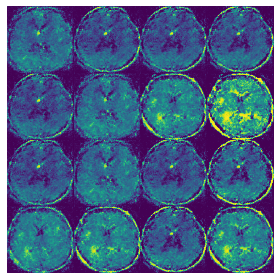

Disc: real loss: 0.333161 fake loss: 0.398172
GAN loss: 2.920138
Step 680 completed. Time took: 1 secs.
Begin step:  681
Disc: real loss: 0.426774 fake loss: 0.370431
GAN loss: 2.947686
Step 681 completed. Time took: 0 secs.
Begin step:  682
Disc: real loss: 0.581931 fake loss: 0.623342
GAN loss: 3.328384
Step 682 completed. Time took: 0 secs.
Begin step:  683
Disc: real loss: 0.454989 fake loss: 0.429636
GAN loss: 2.648959
Step 683 completed. Time took: 0 secs.
Begin step:  684
Disc: real loss: 0.432458 fake loss: 0.410150
GAN loss: 1.848628
Step 684 completed. Time took: 0 secs.
Begin step:  685
Disc: real loss: 0.402835 fake loss: 0.383875
GAN loss: 3.207557
Step 685 completed. Time took: 0 secs.
Begin step:  686
Disc: real loss: 0.491218 fake loss: 0.358624
GAN loss: 1.649180
Step 686 completed. Time took: 0 secs.
Begin step:  687
Disc: real loss: 0.305220 fake loss: 0.379108
GAN loss: 2.721215
Step 687 completed. Time took: 0 secs.
Begin step:  688
Disc: real loss: 0.471861 fake l

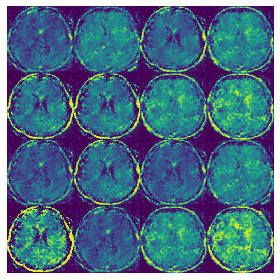

Disc: real loss: 0.405029 fake loss: 0.369315
GAN loss: 2.256856
Step 690 completed. Time took: 1 secs.
Begin step:  691
Disc: real loss: 0.748988 fake loss: 0.755279
GAN loss: 3.409379
Step 691 completed. Time took: 0 secs.
Begin step:  692
Disc: real loss: 0.390486 fake loss: 0.367109
GAN loss: 4.014136
Step 692 completed. Time took: 0 secs.
Begin step:  693
Disc: real loss: 0.301973 fake loss: 0.335979
GAN loss: 2.619477
Step 693 completed. Time took: 0 secs.
Begin step:  694
Disc: real loss: 0.321032 fake loss: 0.464618
GAN loss: 3.061356
Step 694 completed. Time took: 0 secs.
Begin step:  695
Disc: real loss: 0.335473 fake loss: 0.330342
GAN loss: 2.349205
Step 695 completed. Time took: 0 secs.
Begin step:  696
Disc: real loss: 0.334590 fake loss: 0.523833
GAN loss: 4.007370
Step 696 completed. Time took: 0 secs.
Begin step:  697
Disc: real loss: 0.661517 fake loss: 0.378912
GAN loss: 2.265233
Step 697 completed. Time took: 0 secs.
Begin step:  698
Disc: real loss: 0.358012 fake l

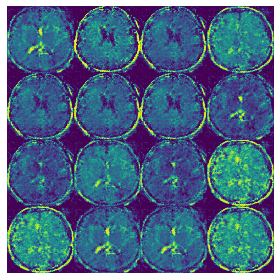

Disc: real loss: 0.321167 fake loss: 0.491947
GAN loss: 2.578943
Step 700 completed. Time took: 1 secs.
Begin step:  701
Disc: real loss: 0.445157 fake loss: 0.439186
GAN loss: 3.506002
Step 701 completed. Time took: 0 secs.
Begin step:  702
Disc: real loss: 0.603961 fake loss: 0.400969
GAN loss: 2.858646
Step 702 completed. Time took: 0 secs.
Begin step:  703
Disc: real loss: 0.354299 fake loss: 0.397290
GAN loss: 2.042498
Step 703 completed. Time took: 0 secs.
Begin step:  704
Disc: real loss: 0.442366 fake loss: 1.174613
GAN loss: 10.064802
Step 704 completed. Time took: 0 secs.
Begin step:  705
Disc: real loss: 3.013346 fake loss: 0.601046
GAN loss: 3.791295
Step 705 completed. Time took: 0 secs.
Begin step:  706
Disc: real loss: 0.474344 fake loss: 0.329398
GAN loss: 1.745215
Step 706 completed. Time took: 0 secs.
Begin step:  707
Disc: real loss: 0.403753 fake loss: 0.437433
GAN loss: 1.564828
Step 707 completed. Time took: 0 secs.
Begin step:  708
Disc: real loss: 0.445778 fake 

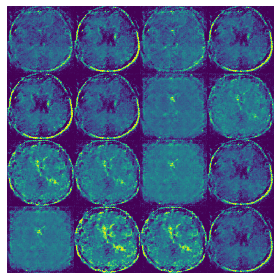

Disc: real loss: 0.661192 fake loss: 0.552559
GAN loss: 2.660989
Step 710 completed. Time took: 1 secs.
Begin step:  711
Disc: real loss: 0.410830 fake loss: 0.301989
GAN loss: 2.250993
Step 711 completed. Time took: 0 secs.
Begin step:  712
Disc: real loss: 0.379597 fake loss: 0.379268
GAN loss: 2.214417
Step 712 completed. Time took: 0 secs.
Begin step:  713
Disc: real loss: 0.413667 fake loss: 0.402382
GAN loss: 1.916616
Step 713 completed. Time took: 0 secs.
Begin step:  714
Disc: real loss: 0.439049 fake loss: 0.370845
GAN loss: 1.844588
Step 714 completed. Time took: 0 secs.
Begin step:  715
Disc: real loss: 0.446975 fake loss: 0.503715
GAN loss: 1.850638
Step 715 completed. Time took: 0 secs.
Begin step:  716
Disc: real loss: 0.412737 fake loss: 0.391907
GAN loss: 2.320826
Step 716 completed. Time took: 0 secs.
Begin step:  717
Disc: real loss: 0.403384 fake loss: 0.328503
GAN loss: 1.853940
Step 717 completed. Time took: 0 secs.
Begin step:  718
Disc: real loss: 0.403181 fake l

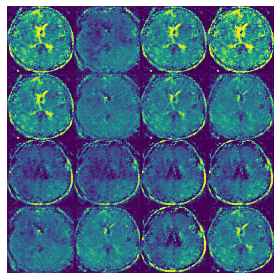

Disc: real loss: 0.550301 fake loss: 0.522079
GAN loss: 2.388734
Step 720 completed. Time took: 1 secs.
Begin step:  721
Disc: real loss: 0.353135 fake loss: 0.372938
GAN loss: 2.381079
Step 721 completed. Time took: 0 secs.
Begin step:  722
Disc: real loss: 0.488203 fake loss: 0.478602
GAN loss: 2.537183
Step 722 completed. Time took: 0 secs.
Begin step:  723
Disc: real loss: 0.418024 fake loss: 0.457904
GAN loss: 3.067267
Step 723 completed. Time took: 0 secs.
Begin step:  724
Disc: real loss: 0.524310 fake loss: 0.414795
GAN loss: 2.171616
Step 724 completed. Time took: 0 secs.
Begin step:  725
Disc: real loss: 0.390113 fake loss: 0.503991
GAN loss: 3.700535
Step 725 completed. Time took: 0 secs.
Begin step:  726
Disc: real loss: 0.403106 fake loss: 0.332389
GAN loss: 2.849717
Step 726 completed. Time took: 0 secs.
Begin step:  727
Disc: real loss: 0.277345 fake loss: 0.497821
GAN loss: 4.537483
Step 727 completed. Time took: 0 secs.
Begin step:  728
Disc: real loss: 0.484028 fake l

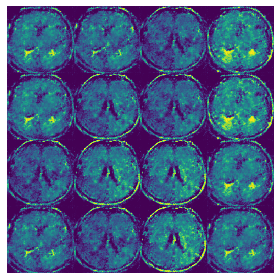

Disc: real loss: 0.518618 fake loss: 0.422999
GAN loss: 2.761075
Step 730 completed. Time took: 1 secs.
Begin step:  731
Disc: real loss: 0.340401 fake loss: 0.351838
GAN loss: 2.302758
Step 731 completed. Time took: 0 secs.
Begin step:  732
Disc: real loss: 0.403427 fake loss: 0.393370
GAN loss: 3.578400
Step 732 completed. Time took: 0 secs.
Begin step:  733
Disc: real loss: 0.465312 fake loss: 0.456822
GAN loss: 3.788557
Step 733 completed. Time took: 0 secs.
Begin step:  734
Disc: real loss: 0.356475 fake loss: 0.357094
GAN loss: 2.938751
Step 734 completed. Time took: 0 secs.
Begin step:  735
Disc: real loss: 0.404708 fake loss: 0.440529
GAN loss: 4.410810
Step 735 completed. Time took: 0 secs.
Begin step:  736
Disc: real loss: 0.533451 fake loss: 0.428056
GAN loss: 2.082666
Step 736 completed. Time took: 0 secs.
Begin step:  737
Disc: real loss: 0.403946 fake loss: 0.475397
GAN loss: 3.348965
Step 737 completed. Time took: 0 secs.
Begin step:  738
Disc: real loss: 0.366819 fake l

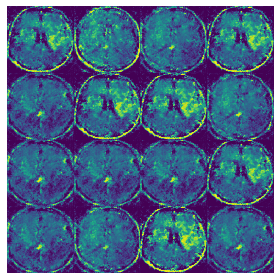

Disc: real loss: 0.331898 fake loss: 0.383432
GAN loss: 3.047710
Step 740 completed. Time took: 1 secs.
Begin step:  741
Disc: real loss: 0.348606 fake loss: 0.354593
GAN loss: 2.227579
Step 741 completed. Time took: 0 secs.
Begin step:  742
Disc: real loss: 0.390238 fake loss: 0.430150
GAN loss: 2.977647
Step 742 completed. Time took: 0 secs.
Begin step:  743
Disc: real loss: 0.398468 fake loss: 0.340231
GAN loss: 2.583724
Step 743 completed. Time took: 0 secs.
Begin step:  744
Disc: real loss: 0.390927 fake loss: 0.323902
GAN loss: 2.547288
Step 744 completed. Time took: 0 secs.
Begin step:  745
Disc: real loss: 0.390684 fake loss: 0.370805
GAN loss: 2.090020
Step 745 completed. Time took: 0 secs.
Begin step:  746
Disc: real loss: 0.398897 fake loss: 0.595658
GAN loss: 3.658405
Step 746 completed. Time took: 0 secs.
Begin step:  747
Disc: real loss: 0.472886 fake loss: 0.450754
GAN loss: 3.607553
Step 747 completed. Time took: 0 secs.
Begin step:  748
Disc: real loss: 0.350174 fake l

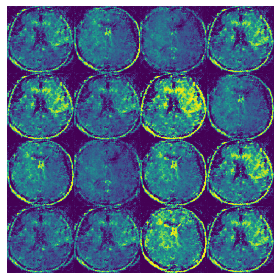

Disc: real loss: 0.393526 fake loss: 0.352189
GAN loss: 2.629984
Step 750 completed. Time took: 1 secs.
Begin step:  751
Disc: real loss: 0.328256 fake loss: 0.347140
GAN loss: 2.279246
Step 751 completed. Time took: 0 secs.
Begin step:  752
Disc: real loss: 0.292469 fake loss: 0.396692
GAN loss: 2.581943
Step 752 completed. Time took: 0 secs.
Begin step:  753
Disc: real loss: 0.353843 fake loss: 0.366754
GAN loss: 2.164966
Step 753 completed. Time took: 0 secs.
Begin step:  754
Disc: real loss: 0.421137 fake loss: 0.429539
GAN loss: 2.637122
Step 754 completed. Time took: 0 secs.
Begin step:  755
Disc: real loss: 0.360083 fake loss: 0.353492
GAN loss: 3.754774
Step 755 completed. Time took: 0 secs.
Begin step:  756
Disc: real loss: 0.354558 fake loss: 0.414333
GAN loss: 2.517451
Step 756 completed. Time took: 0 secs.
Begin step:  757
Disc: real loss: 0.395027 fake loss: 0.396111
GAN loss: 2.678846
Step 757 completed. Time took: 0 secs.
Begin step:  758
Disc: real loss: 0.464698 fake l

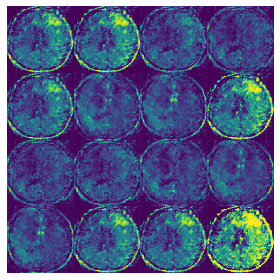

Disc: real loss: 0.347088 fake loss: 0.294448
GAN loss: 1.676633
Step 760 completed. Time took: 1 secs.
Begin step:  761
Disc: real loss: 0.388729 fake loss: 0.363625
GAN loss: 2.556643
Step 761 completed. Time took: 0 secs.
Begin step:  762
Disc: real loss: 0.340981 fake loss: 0.403015
GAN loss: 2.026268
Step 762 completed. Time took: 0 secs.
Begin step:  763
Disc: real loss: 0.367175 fake loss: 0.848810
GAN loss: 5.944477
Step 763 completed. Time took: 0 secs.
Begin step:  764
Disc: real loss: 1.542271 fake loss: 0.529484
GAN loss: 3.401169
Step 764 completed. Time took: 0 secs.
Begin step:  765
Disc: real loss: 0.407524 fake loss: 0.373037
GAN loss: 2.394713
Step 765 completed. Time took: 0 secs.
Begin step:  766
Disc: real loss: 0.359423 fake loss: 0.400670
GAN loss: 1.906767
Step 766 completed. Time took: 0 secs.
Begin step:  767
Disc: real loss: 0.378025 fake loss: 0.393442
GAN loss: 2.427180
Step 767 completed. Time took: 0 secs.
Begin step:  768
Disc: real loss: 0.367956 fake l

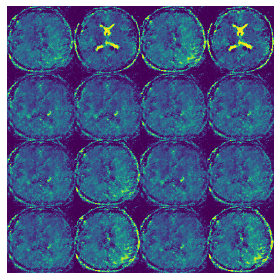

Disc: real loss: 0.350434 fake loss: 0.367452
GAN loss: 1.741085
Step 770 completed. Time took: 1 secs.
Begin step:  771
Disc: real loss: 0.326059 fake loss: 0.414005
GAN loss: 3.479707
Step 771 completed. Time took: 0 secs.
Begin step:  772
Disc: real loss: 0.672522 fake loss: 0.638234
GAN loss: 5.116241
Step 772 completed. Time took: 0 secs.
Begin step:  773
Disc: real loss: 0.380616 fake loss: 0.757937
GAN loss: 4.242488
Step 773 completed. Time took: 0 secs.
Begin step:  774
Disc: real loss: 0.676328 fake loss: 0.630400
GAN loss: 3.479882
Step 774 completed. Time took: 0 secs.
Begin step:  775
Disc: real loss: 0.327187 fake loss: 0.429285
GAN loss: 3.211488
Step 775 completed. Time took: 0 secs.
Begin step:  776
Disc: real loss: 0.323728 fake loss: 0.480256
GAN loss: 2.798975
Step 776 completed. Time took: 0 secs.
Begin step:  777
Disc: real loss: 0.504748 fake loss: 0.706942
GAN loss: 3.613181
Step 777 completed. Time took: 0 secs.
Begin step:  778
Disc: real loss: 0.381235 fake l

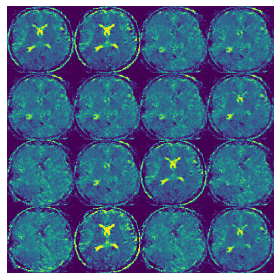

Disc: real loss: 0.313857 fake loss: 0.395812
GAN loss: 2.594502
Step 780 completed. Time took: 1 secs.
Begin step:  781
Disc: real loss: 0.320380 fake loss: 0.332176
GAN loss: 2.894239
Step 781 completed. Time took: 0 secs.
Begin step:  782
Disc: real loss: 0.325030 fake loss: 0.335197
GAN loss: 2.014741
Step 782 completed. Time took: 0 secs.
Begin step:  783
Disc: real loss: 0.341978 fake loss: 0.388182
GAN loss: 2.840988
Step 783 completed. Time took: 0 secs.
Begin step:  784
Disc: real loss: 0.395311 fake loss: 0.362311
GAN loss: 2.092972
Step 784 completed. Time took: 0 secs.
Begin step:  785
Disc: real loss: 0.384323 fake loss: 0.418323
GAN loss: 3.694831
Step 785 completed. Time took: 0 secs.
Begin step:  786
Disc: real loss: 0.717210 fake loss: 0.318840
GAN loss: 2.377307
Step 786 completed. Time took: 0 secs.
Begin step:  787
Disc: real loss: 0.344080 fake loss: 0.284651
GAN loss: 3.240871
Step 787 completed. Time took: 0 secs.
Begin step:  788
Disc: real loss: 0.341070 fake l

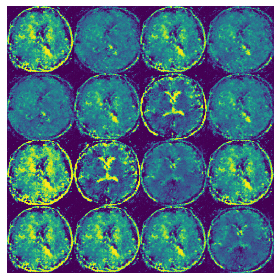

Disc: real loss: 0.330906 fake loss: 0.385278
GAN loss: 1.821792
Step 790 completed. Time took: 1 secs.
Begin step:  791
Disc: real loss: 0.320361 fake loss: 0.477745
GAN loss: 3.427692
Step 791 completed. Time took: 0 secs.
Begin step:  792
Disc: real loss: 0.483641 fake loss: 0.334099
GAN loss: 3.528238
Step 792 completed. Time took: 0 secs.
Begin step:  793
Disc: real loss: 0.484760 fake loss: 0.332558
GAN loss: 1.454216
Step 793 completed. Time took: 0 secs.
Begin step:  794
Disc: real loss: 0.369898 fake loss: 0.400889
GAN loss: 2.147627
Step 794 completed. Time took: 0 secs.
Begin step:  795
Disc: real loss: 0.319125 fake loss: 0.320065
GAN loss: 2.790454
Step 795 completed. Time took: 0 secs.
Begin step:  796
Disc: real loss: 0.432700 fake loss: 0.382578
GAN loss: 2.355222
Step 796 completed. Time took: 0 secs.
Begin step:  797
Disc: real loss: 0.335689 fake loss: 0.435129
GAN loss: 2.426076
Step 797 completed. Time took: 0 secs.
Begin step:  798
Disc: real loss: 0.398841 fake l

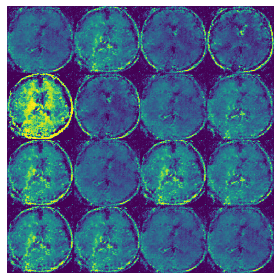

Disc: real loss: 0.398758 fake loss: 0.413188
GAN loss: 2.148091
Step 800 completed. Time took: 1 secs.
Begin step:  801
Disc: real loss: 0.360313 fake loss: 0.402001
GAN loss: 2.625971
Step 801 completed. Time took: 0 secs.
Begin step:  802
Disc: real loss: 0.365881 fake loss: 0.365506
GAN loss: 2.569249
Step 802 completed. Time took: 0 secs.
Begin step:  803
Disc: real loss: 0.417557 fake loss: 0.399888
GAN loss: 2.375026
Step 803 completed. Time took: 0 secs.
Begin step:  804
Disc: real loss: 0.324625 fake loss: 0.389419
GAN loss: 2.269923
Step 804 completed. Time took: 0 secs.
Begin step:  805
Disc: real loss: 0.331368 fake loss: 0.356103
GAN loss: 2.111368
Step 805 completed. Time took: 0 secs.
Begin step:  806
Disc: real loss: 0.364039 fake loss: 0.592684
GAN loss: 3.518707
Step 806 completed. Time took: 0 secs.
Begin step:  807
Disc: real loss: 0.389714 fake loss: 0.347687
GAN loss: 3.085349
Step 807 completed. Time took: 0 secs.
Begin step:  808
Disc: real loss: 0.461842 fake l

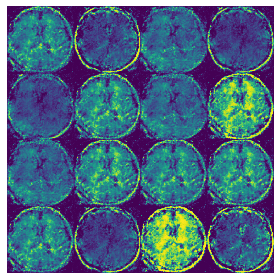

Disc: real loss: 0.408862 fake loss: 0.461422
GAN loss: 4.520243
Step 810 completed. Time took: 1 secs.
Begin step:  811
Disc: real loss: 0.671002 fake loss: 0.676696
GAN loss: 3.286075
Step 811 completed. Time took: 0 secs.
Begin step:  812
Disc: real loss: 0.411390 fake loss: 0.319430
GAN loss: 3.455648
Step 812 completed. Time took: 0 secs.
Begin step:  813
Disc: real loss: 0.474675 fake loss: 0.395154
GAN loss: 1.831027
Step 813 completed. Time took: 0 secs.
Begin step:  814
Disc: real loss: 0.396092 fake loss: 0.364670
GAN loss: 2.153249
Step 814 completed. Time took: 0 secs.
Begin step:  815
Disc: real loss: 0.317490 fake loss: 0.369111
GAN loss: 2.174934
Step 815 completed. Time took: 0 secs.
Begin step:  816
Disc: real loss: 0.464353 fake loss: 0.608442
GAN loss: 3.164698
Step 816 completed. Time took: 0 secs.
Begin step:  817
Disc: real loss: 0.379222 fake loss: 0.385886
GAN loss: 3.263889
Step 817 completed. Time took: 0 secs.
Begin step:  818
Disc: real loss: 0.304594 fake l

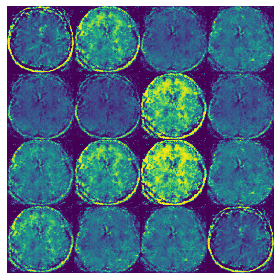

Disc: real loss: 0.403206 fake loss: 0.343593
GAN loss: 2.587671
Step 820 completed. Time took: 1 secs.
Begin step:  821
Disc: real loss: 0.430862 fake loss: 0.559747
GAN loss: 1.984246
Step 821 completed. Time took: 0 secs.
Begin step:  822
Disc: real loss: 0.377300 fake loss: 0.315971
GAN loss: 2.697766
Step 822 completed. Time took: 0 secs.
Begin step:  823
Disc: real loss: 0.440334 fake loss: 0.368323
GAN loss: 1.673677
Step 823 completed. Time took: 0 secs.
Begin step:  824
Disc: real loss: 0.290350 fake loss: 0.392585
GAN loss: 2.024579
Step 824 completed. Time took: 0 secs.
Begin step:  825
Disc: real loss: 0.376730 fake loss: 0.395197
GAN loss: 1.799174
Step 825 completed. Time took: 0 secs.
Begin step:  826
Disc: real loss: 0.403906 fake loss: 0.500336
GAN loss: 3.763980
Step 826 completed. Time took: 0 secs.
Begin step:  827
Disc: real loss: 0.922377 fake loss: 0.601677
GAN loss: 2.428461
Step 827 completed. Time took: 0 secs.
Begin step:  828
Disc: real loss: 0.383998 fake l

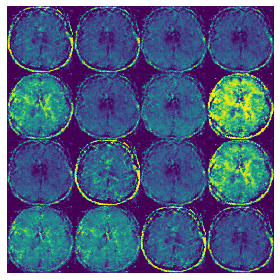

Disc: real loss: 0.382402 fake loss: 0.373488
GAN loss: 1.835728
Step 830 completed. Time took: 1 secs.
Begin step:  831
Disc: real loss: 0.346389 fake loss: 0.415764
GAN loss: 2.407658
Step 831 completed. Time took: 0 secs.
Begin step:  832
Disc: real loss: 0.672055 fake loss: 0.795141
GAN loss: 4.496076
Step 832 completed. Time took: 0 secs.
Begin step:  833
Disc: real loss: 0.516929 fake loss: 0.391751
GAN loss: 2.784205
Step 833 completed. Time took: 0 secs.
Begin step:  834
Disc: real loss: 0.367612 fake loss: 0.683688
GAN loss: 3.440486
Step 834 completed. Time took: 0 secs.
Begin step:  835
Disc: real loss: 0.535046 fake loss: 0.518276
GAN loss: 5.666746
Step 835 completed. Time took: 0 secs.
Begin step:  836
Disc: real loss: 0.331651 fake loss: 0.363874
GAN loss: 2.913628
Step 836 completed. Time took: 0 secs.
Begin step:  837
Disc: real loss: 0.353193 fake loss: 0.351014
GAN loss: 2.316438
Step 837 completed. Time took: 0 secs.
Begin step:  838
Disc: real loss: 0.410148 fake l

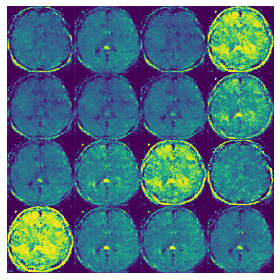

Disc: real loss: 0.362543 fake loss: 0.317500
GAN loss: 2.076746
Step 840 completed. Time took: 1 secs.
Begin step:  841
Disc: real loss: 0.327380 fake loss: 0.395464
GAN loss: 3.084911
Step 841 completed. Time took: 0 secs.
Begin step:  842
Disc: real loss: 0.382351 fake loss: 0.347513
GAN loss: 2.243249
Step 842 completed. Time took: 0 secs.
Begin step:  843
Disc: real loss: 0.388128 fake loss: 0.343882
GAN loss: 1.818878
Step 843 completed. Time took: 0 secs.
Begin step:  844
Disc: real loss: 0.417567 fake loss: 0.377620
GAN loss: 2.396182
Step 844 completed. Time took: 0 secs.
Begin step:  845
Disc: real loss: 0.495675 fake loss: 0.404821
GAN loss: 3.487584
Step 845 completed. Time took: 0 secs.
Begin step:  846
Disc: real loss: 0.410591 fake loss: 0.321920
GAN loss: 3.350847
Step 846 completed. Time took: 0 secs.
Begin step:  847
Disc: real loss: 0.341940 fake loss: 0.403292
GAN loss: 2.235460
Step 847 completed. Time took: 0 secs.
Begin step:  848
Disc: real loss: 0.348334 fake l

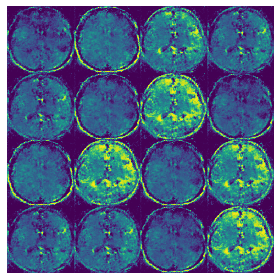

Disc: real loss: 0.346165 fake loss: 0.344803
GAN loss: 2.563379
Step 850 completed. Time took: 1 secs.
Begin step:  851
Disc: real loss: 0.309372 fake loss: 0.301704
GAN loss: 2.326923
Step 851 completed. Time took: 0 secs.
Begin step:  852
Disc: real loss: 0.344595 fake loss: 0.380785
GAN loss: 1.220151
Step 852 completed. Time took: 0 secs.
Begin step:  853
Disc: real loss: 0.322621 fake loss: 0.595179
GAN loss: 5.253261
Step 853 completed. Time took: 0 secs.
Begin step:  854
Disc: real loss: 1.129817 fake loss: 0.365279
GAN loss: 1.884088
Step 854 completed. Time took: 0 secs.
Begin step:  855
Disc: real loss: 0.502397 fake loss: 0.360241
GAN loss: 3.008445
Step 855 completed. Time took: 0 secs.
Begin step:  856
Disc: real loss: 0.367142 fake loss: 0.377650
GAN loss: 2.395324
Step 856 completed. Time took: 0 secs.
Begin step:  857
Disc: real loss: 0.400821 fake loss: 0.320367
GAN loss: 2.211386
Step 857 completed. Time took: 0 secs.
Begin step:  858
Disc: real loss: 0.408321 fake l

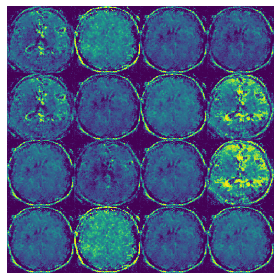

Disc: real loss: 0.359070 fake loss: 0.328469
GAN loss: 2.776783
Step 860 completed. Time took: 1 secs.
Begin step:  861
Disc: real loss: 0.485324 fake loss: 0.431281
GAN loss: 3.384469
Step 861 completed. Time took: 0 secs.
Begin step:  862
Disc: real loss: 0.435306 fake loss: 0.426682
GAN loss: 2.399608
Step 862 completed. Time took: 0 secs.
Begin step:  863
Disc: real loss: 0.346322 fake loss: 0.339931
GAN loss: 2.261544
Step 863 completed. Time took: 0 secs.
Begin step:  864
Disc: real loss: 0.448269 fake loss: 0.308990
GAN loss: 2.197845
Step 864 completed. Time took: 0 secs.
Begin step:  865
Disc: real loss: 0.449587 fake loss: 0.386970
GAN loss: 1.928494
Step 865 completed. Time took: 0 secs.
Begin step:  866
Disc: real loss: 0.445153 fake loss: 0.400326
GAN loss: 3.282673
Step 866 completed. Time took: 0 secs.
Begin step:  867
Disc: real loss: 0.510648 fake loss: 0.481753
GAN loss: 3.183326
Step 867 completed. Time took: 0 secs.
Begin step:  868
Disc: real loss: 0.369362 fake l

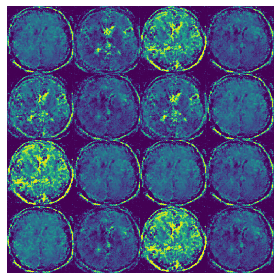

Disc: real loss: 0.364399 fake loss: 0.461402
GAN loss: 3.752813
Step 870 completed. Time took: 1 secs.
Begin step:  871
Disc: real loss: 0.421996 fake loss: 0.331591
GAN loss: 1.654592
Step 871 completed. Time took: 0 secs.
Begin step:  872
Disc: real loss: 0.415003 fake loss: 0.496334
GAN loss: 3.706033
Step 872 completed. Time took: 0 secs.
Begin step:  873
Disc: real loss: 0.456555 fake loss: 0.347353
GAN loss: 2.461425
Step 873 completed. Time took: 0 secs.
Begin step:  874
Disc: real loss: 0.399800 fake loss: 0.368618
GAN loss: 2.621962
Step 874 completed. Time took: 0 secs.
Begin step:  875
Disc: real loss: 0.419820 fake loss: 0.353742
GAN loss: 1.942291
Step 875 completed. Time took: 0 secs.
Begin step:  876
Disc: real loss: 0.353985 fake loss: 0.399754
GAN loss: 2.461695
Step 876 completed. Time took: 0 secs.
Begin step:  877
Disc: real loss: 0.354201 fake loss: 0.370095
GAN loss: 3.183836
Step 877 completed. Time took: 0 secs.
Begin step:  878
Disc: real loss: 0.358489 fake l

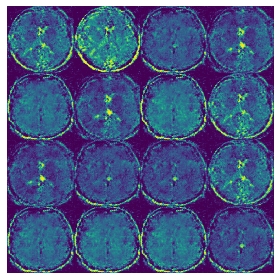

Disc: real loss: 0.420626 fake loss: 0.573812
GAN loss: 3.875244
Step 880 completed. Time took: 1 secs.
Begin step:  881
Disc: real loss: 0.577245 fake loss: 0.348752
GAN loss: 2.558646
Step 881 completed. Time took: 0 secs.
Begin step:  882
Disc: real loss: 0.417953 fake loss: 0.379576
GAN loss: 2.809925
Step 882 completed. Time took: 0 secs.
Begin step:  883
Disc: real loss: 0.332356 fake loss: 0.341671
GAN loss: 2.971058
Step 883 completed. Time took: 0 secs.
Begin step:  884
Disc: real loss: 0.367149 fake loss: 0.445316
GAN loss: 1.983522
Step 884 completed. Time took: 0 secs.
Begin step:  885
Disc: real loss: 0.373635 fake loss: 0.424996
GAN loss: 2.859302
Step 885 completed. Time took: 0 secs.
Begin step:  886
Disc: real loss: 0.526543 fake loss: 0.487243
GAN loss: 2.339350
Step 886 completed. Time took: 0 secs.
Begin step:  887
Disc: real loss: 0.372855 fake loss: 0.436839
GAN loss: 3.030891
Step 887 completed. Time took: 0 secs.
Begin step:  888
Disc: real loss: 0.315450 fake l

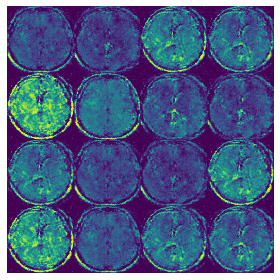

Disc: real loss: 0.549046 fake loss: 0.436285
GAN loss: 2.707572
Step 890 completed. Time took: 1 secs.
Begin step:  891
Disc: real loss: 0.354101 fake loss: 0.444350
GAN loss: 2.670730
Step 891 completed. Time took: 0 secs.
Begin step:  892
Disc: real loss: 0.334946 fake loss: 0.359282
GAN loss: 1.876623
Step 892 completed. Time took: 0 secs.
Begin step:  893
Disc: real loss: 0.381986 fake loss: 0.960087
GAN loss: 6.856638
Step 893 completed. Time took: 0 secs.
Begin step:  894
Disc: real loss: 1.330911 fake loss: 0.677947
GAN loss: 3.631239
Step 894 completed. Time took: 0 secs.
Begin step:  895
Disc: real loss: 0.520059 fake loss: 0.339869
GAN loss: 2.399478
Step 895 completed. Time took: 0 secs.
Begin step:  896
Disc: real loss: 0.442775 fake loss: 0.403787
GAN loss: 2.099096
Step 896 completed. Time took: 0 secs.
Begin step:  897
Disc: real loss: 0.403634 fake loss: 0.373416
GAN loss: 2.189471
Step 897 completed. Time took: 0 secs.
Begin step:  898
Disc: real loss: 0.507832 fake l

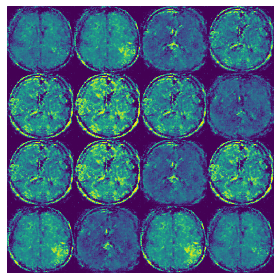

Disc: real loss: 0.356324 fake loss: 0.432720
GAN loss: 2.407815
Step 900 completed. Time took: 1 secs.
Begin step:  901
Disc: real loss: 0.283303 fake loss: 0.343210
GAN loss: 2.367894
Step 901 completed. Time took: 0 secs.
Begin step:  902
Disc: real loss: 0.412432 fake loss: 0.305756
GAN loss: 1.669622
Step 902 completed. Time took: 0 secs.
Begin step:  903
Disc: real loss: 0.293109 fake loss: 0.340863
GAN loss: 1.896952
Step 903 completed. Time took: 0 secs.
Begin step:  904
Disc: real loss: 0.365844 fake loss: 0.364546
GAN loss: 2.372394
Step 904 completed. Time took: 0 secs.
Begin step:  905
Disc: real loss: 0.367940 fake loss: 0.385945
GAN loss: 2.181040
Step 905 completed. Time took: 0 secs.
Begin step:  906
Disc: real loss: 0.336396 fake loss: 0.322031
GAN loss: 2.799341
Step 906 completed. Time took: 0 secs.
Begin step:  907
Disc: real loss: 0.398272 fake loss: 0.371418
GAN loss: 1.902449
Step 907 completed. Time took: 0 secs.
Begin step:  908
Disc: real loss: 0.360893 fake l

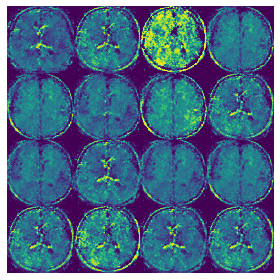

Disc: real loss: 0.331867 fake loss: 0.359957
GAN loss: 1.742270
Step 910 completed. Time took: 1 secs.
Begin step:  911
Disc: real loss: 0.296969 fake loss: 0.361407
GAN loss: 4.254315
Step 911 completed. Time took: 0 secs.
Begin step:  912
Disc: real loss: 0.871454 fake loss: 0.490277
GAN loss: 3.422961
Step 912 completed. Time took: 0 secs.
Begin step:  913
Disc: real loss: 0.384677 fake loss: 0.474490
GAN loss: 2.699442
Step 913 completed. Time took: 0 secs.
Begin step:  914
Disc: real loss: 0.437090 fake loss: 0.357207
GAN loss: 1.777836
Step 914 completed. Time took: 0 secs.
Begin step:  915
Disc: real loss: 0.366177 fake loss: 0.398804
GAN loss: 1.969964
Step 915 completed. Time took: 0 secs.
Begin step:  916
Disc: real loss: 0.348530 fake loss: 0.331885
GAN loss: 2.280155
Step 916 completed. Time took: 0 secs.
Begin step:  917
Disc: real loss: 0.412194 fake loss: 0.388264
GAN loss: 2.746728
Step 917 completed. Time took: 0 secs.
Begin step:  918
Disc: real loss: 0.335296 fake l

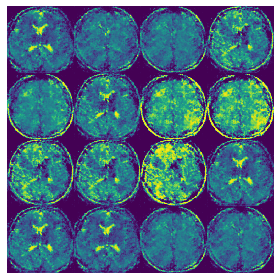

Disc: real loss: 0.394014 fake loss: 0.840820
GAN loss: 6.851064
Step 920 completed. Time took: 1 secs.
Begin step:  921
Disc: real loss: 0.474474 fake loss: 0.525192
GAN loss: 3.389747
Step 921 completed. Time took: 0 secs.
Begin step:  922
Disc: real loss: 0.362340 fake loss: 0.368867
GAN loss: 2.269930
Step 922 completed. Time took: 0 secs.
Begin step:  923
Disc: real loss: 0.426823 fake loss: 0.358484
GAN loss: 2.096805
Step 923 completed. Time took: 0 secs.
Begin step:  924
Disc: real loss: 0.397638 fake loss: 0.363050
GAN loss: 2.752115
Step 924 completed. Time took: 0 secs.
Begin step:  925
Disc: real loss: 0.300183 fake loss: 0.362764
GAN loss: 2.735788
Step 925 completed. Time took: 0 secs.
Begin step:  926
Disc: real loss: 0.311703 fake loss: 0.329402
GAN loss: 1.992670
Step 926 completed. Time took: 0 secs.
Begin step:  927
Disc: real loss: 0.378942 fake loss: 0.364708
GAN loss: 1.682065
Step 927 completed. Time took: 0 secs.
Begin step:  928
Disc: real loss: 0.376067 fake l

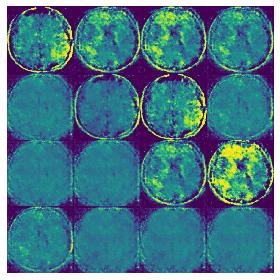

Disc: real loss: 0.336038 fake loss: 0.296247
GAN loss: 2.621629
Step 930 completed. Time took: 1 secs.
Begin step:  931
Disc: real loss: 0.362680 fake loss: 0.350043
GAN loss: 1.846704
Step 931 completed. Time took: 0 secs.
Begin step:  932
Disc: real loss: 0.337285 fake loss: 0.340002
GAN loss: 1.369386
Step 932 completed. Time took: 0 secs.
Begin step:  933
Disc: real loss: 0.338886 fake loss: 0.431366
GAN loss: 1.848269
Step 933 completed. Time took: 0 secs.
Begin step:  934
Disc: real loss: 0.375573 fake loss: 0.349219
GAN loss: 2.035939
Step 934 completed. Time took: 0 secs.
Begin step:  935
Disc: real loss: 0.375375 fake loss: 0.369471
GAN loss: 2.519525
Step 935 completed. Time took: 0 secs.
Begin step:  936
Disc: real loss: 0.403682 fake loss: 0.371895
GAN loss: 2.215766
Step 936 completed. Time took: 0 secs.
Begin step:  937
Disc: real loss: 0.338142 fake loss: 0.360600
GAN loss: 2.196048
Step 937 completed. Time took: 0 secs.
Begin step:  938
Disc: real loss: 0.342212 fake l

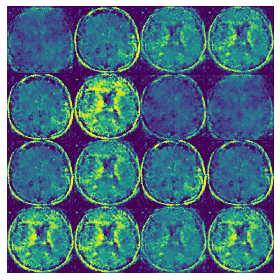

Disc: real loss: 0.493125 fake loss: 0.356640
GAN loss: 1.536803
Step 940 completed. Time took: 1 secs.
Begin step:  941
Disc: real loss: 0.397303 fake loss: 0.388702
GAN loss: 2.172215
Step 941 completed. Time took: 0 secs.
Begin step:  942
Disc: real loss: 0.336687 fake loss: 0.441270
GAN loss: 2.367053
Step 942 completed. Time took: 0 secs.
Begin step:  943
Disc: real loss: 0.410738 fake loss: 0.397239
GAN loss: 1.637528
Step 943 completed. Time took: 0 secs.
Begin step:  944
Disc: real loss: 0.349082 fake loss: 0.471546
GAN loss: 4.789601
Step 944 completed. Time took: 0 secs.
Begin step:  945
Disc: real loss: 0.865237 fake loss: 0.500329
GAN loss: 2.079067
Step 945 completed. Time took: 0 secs.
Begin step:  946
Disc: real loss: 0.504873 fake loss: 0.336331
GAN loss: 2.791404
Step 946 completed. Time took: 0 secs.
Begin step:  947
Disc: real loss: 0.409752 fake loss: 0.347341
GAN loss: 2.836490
Step 947 completed. Time took: 0 secs.
Begin step:  948
Disc: real loss: 0.371237 fake l

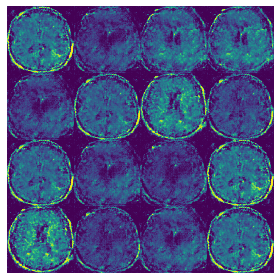

Disc: real loss: 0.430216 fake loss: 0.623583
GAN loss: 4.704917
Step 950 completed. Time took: 1 secs.
Begin step:  951
Disc: real loss: 0.726437 fake loss: 0.526017
GAN loss: 3.287519
Step 951 completed. Time took: 0 secs.
Begin step:  952
Disc: real loss: 0.353841 fake loss: 0.400995
GAN loss: 2.525914
Step 952 completed. Time took: 0 secs.
Begin step:  953
Disc: real loss: 0.314931 fake loss: 0.323868
GAN loss: 2.196990
Step 953 completed. Time took: 0 secs.
Begin step:  954
Disc: real loss: 0.367186 fake loss: 0.346972
GAN loss: 2.406853
Step 954 completed. Time took: 0 secs.
Begin step:  955
Disc: real loss: 0.382573 fake loss: 0.451526
GAN loss: 3.532174
Step 955 completed. Time took: 0 secs.
Begin step:  956
Disc: real loss: 0.412621 fake loss: 0.366074
GAN loss: 2.163956
Step 956 completed. Time took: 0 secs.
Begin step:  957
Disc: real loss: 0.308320 fake loss: 0.470332
GAN loss: 3.002271
Step 957 completed. Time took: 0 secs.
Begin step:  958
Disc: real loss: 0.347267 fake l

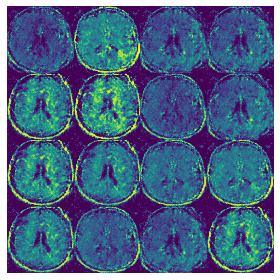

Disc: real loss: 0.324690 fake loss: 0.482696
GAN loss: 3.461343
Step 960 completed. Time took: 1 secs.
Begin step:  961
Disc: real loss: 0.405386 fake loss: 0.354581
GAN loss: 1.826471
Step 961 completed. Time took: 0 secs.
Begin step:  962
Disc: real loss: 0.334446 fake loss: 0.425468
GAN loss: 3.080157
Step 962 completed. Time took: 0 secs.
Begin step:  963
Disc: real loss: 0.343156 fake loss: 0.405989
GAN loss: 3.014347
Step 963 completed. Time took: 0 secs.
Begin step:  964
Disc: real loss: 0.377681 fake loss: 0.338286
GAN loss: 1.750586
Step 964 completed. Time took: 0 secs.
Begin step:  965
Disc: real loss: 0.424737 fake loss: 0.749747
GAN loss: 5.080797
Step 965 completed. Time took: 0 secs.
Begin step:  966
Disc: real loss: 0.771466 fake loss: 0.650661
GAN loss: 3.116394
Step 966 completed. Time took: 0 secs.
Begin step:  967
Disc: real loss: 0.323572 fake loss: 0.451522
GAN loss: 3.002192
Step 967 completed. Time took: 0 secs.
Begin step:  968
Disc: real loss: 0.403840 fake l

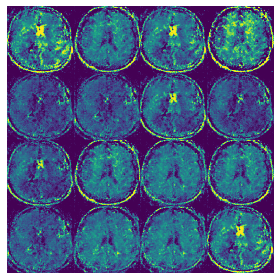

Disc: real loss: 0.349415 fake loss: 0.532675
GAN loss: 3.759972
Step 970 completed. Time took: 1 secs.
Begin step:  971
Disc: real loss: 0.359774 fake loss: 0.533841
GAN loss: 3.472137
Step 971 completed. Time took: 0 secs.
Begin step:  972
Disc: real loss: 0.502427 fake loss: 0.563249
GAN loss: 2.770482
Step 972 completed. Time took: 0 secs.
Begin step:  973
Disc: real loss: 0.391615 fake loss: 0.494232
GAN loss: 4.186381
Step 973 completed. Time took: 0 secs.
Begin step:  974
Disc: real loss: 0.489449 fake loss: 0.352949
GAN loss: 2.074667
Step 974 completed. Time took: 0 secs.
Begin step:  975
Disc: real loss: 0.402935 fake loss: 0.442615
GAN loss: 3.155677
Step 975 completed. Time took: 0 secs.
Begin step:  976
Disc: real loss: 0.333078 fake loss: 0.487596
GAN loss: 2.945879
Step 976 completed. Time took: 0 secs.
Begin step:  977
Disc: real loss: 0.346531 fake loss: 0.331701
GAN loss: 2.267012
Step 977 completed. Time took: 0 secs.
Begin step:  978
Disc: real loss: 0.295988 fake l

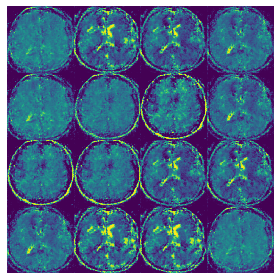

Disc: real loss: 0.275452 fake loss: 0.388630
GAN loss: 2.641879
Step 980 completed. Time took: 1 secs.
Begin step:  981
Disc: real loss: 0.347038 fake loss: 0.505798
GAN loss: 2.998641
Step 981 completed. Time took: 0 secs.
Begin step:  982
Disc: real loss: 0.318274 fake loss: 0.510645
GAN loss: 2.834143
Step 982 completed. Time took: 0 secs.
Begin step:  983
Disc: real loss: 0.371225 fake loss: 0.601254
GAN loss: 5.003582
Step 983 completed. Time took: 0 secs.
Begin step:  984
Disc: real loss: 0.712016 fake loss: 0.944070
GAN loss: 4.036184
Step 984 completed. Time took: 0 secs.
Begin step:  985
Disc: real loss: 0.401503 fake loss: 0.404639
GAN loss: 2.526462
Step 985 completed. Time took: 0 secs.
Begin step:  986
Disc: real loss: 0.342862 fake loss: 0.385851
GAN loss: 2.499884
Step 986 completed. Time took: 0 secs.
Begin step:  987
Disc: real loss: 0.350476 fake loss: 0.348430
GAN loss: 2.323681
Step 987 completed. Time took: 0 secs.
Begin step:  988
Disc: real loss: 0.263915 fake l

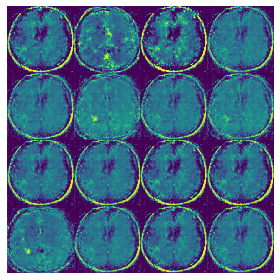

Disc: real loss: 0.436432 fake loss: 0.313843
GAN loss: 2.000386
Step 990 completed. Time took: 1 secs.
Begin step:  991
Disc: real loss: 0.363730 fake loss: 0.321393
GAN loss: 2.113936
Step 991 completed. Time took: 0 secs.
Begin step:  992
Disc: real loss: 0.334369 fake loss: 0.369006
GAN loss: 2.146595
Step 992 completed. Time took: 0 secs.
Begin step:  993
Disc: real loss: 0.321070 fake loss: 0.330776
GAN loss: 1.603682
Step 993 completed. Time took: 0 secs.
Begin step:  994
Disc: real loss: 0.343217 fake loss: 0.650236
GAN loss: 4.215084
Step 994 completed. Time took: 0 secs.
Begin step:  995
Disc: real loss: 1.471139 fake loss: 0.459701
GAN loss: 1.811948
Step 995 completed. Time took: 0 secs.
Begin step:  996
Disc: real loss: 0.534680 fake loss: 0.450070
GAN loss: 3.936679
Step 996 completed. Time took: 0 secs.
Begin step:  997
Disc: real loss: 0.317158 fake loss: 0.414156
GAN loss: 2.814292
Step 997 completed. Time took: 0 secs.
Begin step:  998
Disc: real loss: 0.430731 fake l

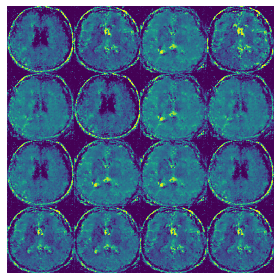

Disc: real loss: 0.306857 fake loss: 0.378762
GAN loss: 2.990350
Step 1000 completed. Time took: 1 secs.
Begin step:  1001
Disc: real loss: 0.367527 fake loss: 0.381457
GAN loss: 2.253303
Step 1001 completed. Time took: 0 secs.
Begin step:  1002
Disc: real loss: 0.365938 fake loss: 0.420133
GAN loss: 4.125860
Step 1002 completed. Time took: 0 secs.
Begin step:  1003
Disc: real loss: 0.563417 fake loss: 0.327236
GAN loss: 2.121045
Step 1003 completed. Time took: 0 secs.
Begin step:  1004
Disc: real loss: 0.435914 fake loss: 0.433152
GAN loss: 3.957157
Step 1004 completed. Time took: 0 secs.
Begin step:  1005
Disc: real loss: 0.386563 fake loss: 0.454564
GAN loss: 2.383194
Step 1005 completed. Time took: 0 secs.
Begin step:  1006
Disc: real loss: 0.364969 fake loss: 0.570460
GAN loss: 5.340304
Step 1006 completed. Time took: 0 secs.
Begin step:  1007
Disc: real loss: 0.531428 fake loss: 0.485015
GAN loss: 3.733645
Step 1007 completed. Time took: 0 secs.
Begin step:  1008
Disc: real loss:

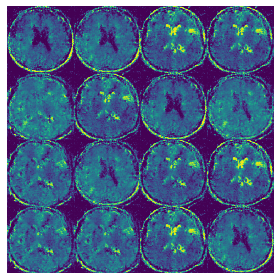

Disc: real loss: 0.407814 fake loss: 0.328350
GAN loss: 2.977851
Step 1010 completed. Time took: 1 secs.
Begin step:  1011
Disc: real loss: 0.490384 fake loss: 0.331760
GAN loss: 2.275651
Step 1011 completed. Time took: 0 secs.
Begin step:  1012
Disc: real loss: 0.344866 fake loss: 0.369428
GAN loss: 2.270761
Step 1012 completed. Time took: 0 secs.
Begin step:  1013
Disc: real loss: 0.393285 fake loss: 0.322216
GAN loss: 1.906644
Step 1013 completed. Time took: 0 secs.
Begin step:  1014
Disc: real loss: 0.331726 fake loss: 0.357618
GAN loss: 3.155083
Step 1014 completed. Time took: 0 secs.
Begin step:  1015
Disc: real loss: 0.455072 fake loss: 0.343723
GAN loss: 2.141129
Step 1015 completed. Time took: 0 secs.
Begin step:  1016
Disc: real loss: 0.317828 fake loss: 0.309360
GAN loss: 2.404227
Step 1016 completed. Time took: 0 secs.
Begin step:  1017
Disc: real loss: 0.304568 fake loss: 0.300158
GAN loss: 2.125327
Step 1017 completed. Time took: 0 secs.
Begin step:  1018
Disc: real loss:

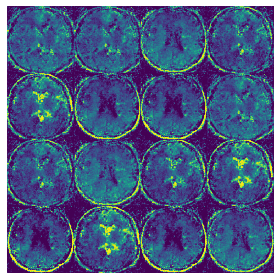

In [0]:
for step in range(num_steps): 
    tot_step = step
    print("Begin step: ", tot_step)
    step_begin_time = time.time() 
    
    real_data_X = sample_from_dataset(batch_size, image_shape, data_dir = data_dir)
    
    fake_data_X = vae.predict(real_data_X)
    
    if (tot_step % 10) == 0:
        step_num = str(tot_step).zfill(4)
        save_img_batch(fake_data_X,img_save_dir+step_num+"_image.png")

    #concatenate real and fake data samples    
    data_X = np.concatenate([real_data_X,fake_data_X])
    #add noise to the label inputs
    real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
    
    
    fake_data_Y = np.random.random_sample(batch_size)*0.2
     
    data_Y = np.concatenate((real_data_Y,fake_data_Y))
        
    discriminator.trainable = True
    vae.trainable = False
    #training the discriminator on real and fake data can be done together, i.e., 
    #on the data_x and data_y, OR it can be done 
    #one by one as performed below. This is the safer choice and gives better results 
    #as compared to combining the real and generated samples.
    dis_metrics_real = discriminator.train_on_batch(real_data_X,real_data_Y)  
    dis_metrics_fake = discriminator.train_on_batch(fake_data_X,fake_data_Y)   
    
    print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))
    
    
    avg_disc_fake_loss.append(dis_metrics_fake[0])
    avg_disc_real_loss.append(dis_metrics_real[0])
    
    vae.trainable = True

    GAN_X = sample_from_dataset(batch_size, image_shape, data_dir = data_dir)

    GAN_Y = real_data_Y
    
    discriminator.trainable = False
    
    gan_metrics = gan.train_on_batch(GAN_X,GAN_Y)
    print("GAN loss: %f" % (gan_metrics[0]))
    
    text_file = open(log_dir+"training_log.txt", "a")
    text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0],
                                                                                   dis_metrics_fake[0],gan_metrics[0]))
    text_file.close()
    avg_GAN_loss.append(gan_metrics[0])
    
        
    end_time = time.time()
    diff_time = int(end_time - step_begin_time)
    print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))
    
    if ((tot_step+1) % 200) == 0:
        print("-----------------------------------------------------------------")
        print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss)))    
        print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss)))    
        print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
        print("-----------------------------------------------------------------")
        discriminator.trainable = True
        vae.trainable = True
        vae.save(save_model_dir+str(tot_step)+"_VAE_weights_and_arch.hdf5")
        discriminator.save(save_model_dir+str(tot_step)+"_DISCRIMINATOR_weights_and_arch.hdf5")

In [22]:
!ls '/content/drive/My Drive/deep learn/dataBrainMRI_256/'

healthy_original  results  results_256	results_vaegan_256  tumor_original


In [0]:
test_data = []
for file_ in os.listdir('/content/drive/My Drive/deep learn/dataBrainMRI_256/tumor_original/'):
  test_data.append(plt.imread(os.path.join('/content/drive/My Drive/deep learn/dataBrainMRI_256/tumor_original/', file_))[:256,:256,:1].reshape(256,256,1))
x_test = np.asarray(test_data)

In [0]:
pred_img = generator.predict(nnn)

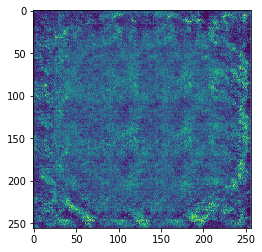

In [0]:
plt.imshow(pred_img.reshape(256,256))